# 1. Exploratory data analysis
# 2. Machine learning 
 - Linear regression with Lasso, Ridge and Elastic net
 - Regression with None, Lasso, Ridge and ElasticNet
 - LogisticRegression with Lasso, Ridge and Elasticnet
 - MLPRegressor
 - k-NN regressor
 - K-means
 - Support vectore machine
 - Gaussian Naive Bayes (GaussianNB)
 - Decision Tree Regressor
  - Gradient Boosting Regressor
  - adaboost regressor
  - SGDRegressor
  - RandomForest Regressor
  - XGBoost Regressor
  - lightgbm Regressor
  - Catboost
 - Fbprophet
 
# 3. Deep learning 
 - CNN (Convolutional Neural Network)
 - RNN (Recurrent neural network)
 - LSTM (Long short-term memory)
 - GRU (Gated recurrent units)
 - bidirectional LSTM

# 4. statistics analysis
 - ARIMA (Auto Regressive Integrated Moving Average)


### Version Check

In [1]:
import sklearn
print(sklearn.__version__)

0.23.2


In [2]:
import warnings

warnings.filterwarnings(action='ignore')
import tensorflow
print(tensorflow.__version__)

1.14.0


In [3]:
#|!pip install plotly

# 1.Exploratory data analysis

### jupyter notebook powerpoint setting 

In [4]:
# !conda install -c conda-forge rise

In [5]:
# !pip install RISE

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as py # 과학 그래프 라이브러리뿐만 아니라 개인 및 공동 작업을위한 온라인 그래프, 분석 및 통계 도구를 제공합니다.
import plotly.express as px

cases = pd.read_csv("./Novel Corona Virus 2019 Dataset/494724_1313523_bundle_archive/covid_19_data.csv")

py.init_notebook_mode(connected = True)
grp = cases.groupby(['ObservationDate', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered'].max()
grp = grp.reset_index()
grp['Date'] = pd.to_datetime(grp['ObservationDate'])
grp['Date'] = grp['Date'].dt.strftime('%m/%d/%Y')
grp['Active'] = grp['Confirmed'] - grp['Recovered'] - grp['Deaths']
grp['Country'] =  grp['Country/Region']
fig = px.choropleth(grp, locations="Country", locationmode='country names', 
                     color="Confirmed", hover_name="Country/Region",hover_data = [grp.Recovered,grp.Deaths,grp.Active],projection="natural earth",
                     animation_frame="Date",width=1000, height=700,
                     color_continuous_scale='Reds',
                     range_color=[1000,50000],

                     title='World Map of Coronavirus')

fig.update(layout_coloraxis_showscale=True)
py.offline.iplot(fig)

In [7]:
# symptoms={'symptom':['Fever',
#         'Dry cough',
#         'Fatigue',
#         'Sputum production',
#         'Shortness of breath',
#         'Muscle pain',
#         'Sore throat',
#         'Headache',
#         'Chills',
#         'Nausea or vomiting',
#         'Nasal congestion',
#         'Diarrhoea',
#         'Haemoptysis',
#         'Conjunctival congestion'],'percentage':[87.9,67.7,38.1,33.4,18.6,14.8,13.9,13.6,11.4,5.0,4.8,3.7,0.9,0.8]}
# #
# symptoms=pd.DataFrame(data=symptoms,index=range(14))
# symptoms

In [8]:
# fig = px.bar(symptoms[['symptom', 'percentage']].sort_values('percentage', ascending=False), 
#              y="percentage", x="symptom", color='symptom', 
#              log_y=True, template='ggplot2', title='Symptom of  Coronavirus')
# fig.show()

In [9]:
# fig = px.pie(symptoms,
#              values="percentage",
#              names="symptom",
#              template="seaborn")
# fig.update_traces(rotation=90, pull=0.05, textinfo="percent+label")
# fig.show()

In [10]:
# fig = px.treemap(symptoms, path=['symptom'], values='percentage',
#                   color='percentage', hover_data=['symptom'],
#                   color_continuous_scale='Rainbow')
# fig.show()

In [11]:
# fig = px.scatter(symptoms[['symptom', 'percentage']].sort_values('percentage', ascending=False), 
#              y="percentage", x="symptom", color='symptom', 
#              log_y=True, template='ggplot2', title='Symptom of  Coronavirus')
# fig.show()

In [12]:
# fig = px.violin(symptoms[['symptom', 'percentage']].sort_values('percentage', ascending=False), 
#              y="percentage", x="symptom", color='symptom', 
#              log_y=True, template='ggplot2', title='Symptom of  Coronavirus')
# fig.show()

In [13]:
# from wordcloud import WordCloud, ImageColorGenerator
# from matplotlib import pyplot as plt
# text = " ".join(str(each) for each in symptoms.symptom)
# wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="white").generate(text)
# plt.figure(figsize=(10,6))
# plt.figure(figsize=(15,10))
# plt.imshow(wordcloud, interpolation='Bilinear')
# plt.axis("off")
# plt.figure(1,figsize=(12, 12))
# plt.show()

 ### Data load

In [14]:
patient = pd.read_csv('./Data Science for Covid19(DS4C)/Patientinfo.csv')
route = pd.read_csv('./Data Science for Covid19(DS4C)/PatientRoute.csv')

In [15]:
patient.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50s,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


In [16]:
route.head()

,patient_id,date,province,city,type,latitude,longitude
0,1000000001,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.61525,126.7156
1,1000000001,2020-01-24,Seoul,Jung-gu,hospital,37.56724,127.0057
2,1000000002,2020-01-25,Seoul,Seongbuk-gu,etc,37.59256,127.0170
3,1000000002,2020-01-26,Seoul,Seongbuk-gu,store,37.59181,127.0168
4,1000000002,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.56399,127.0295


1. id the ID of the patient (n-th confirmed patient)
2. sex the sex of the patient
3. birth_year the birth year of the patient
4. country the country of the patient
5. region the region of the patient
6. group the collective infection
7. infection_reason the reason of infection
8. infection_order the order of infection
9. infected_by the ID of who has infected the patient
10. contact_number the number of contacts with people
11. confirmed_date the date of confirmation
12. released_date the date of discharge
13. deceased_date the date of decease
14. state isolated / released / deceased

In [17]:
patient.shape

(5165, 14)

In [18]:
route.shape

(10410, 7)

In [19]:
patient.isna().sum() # Detect missing values.

patient_id               0
sex                   1122
age                   1380
country                  0
province                 0
city                    94
infection_case         919
infected_by           3819
contact_number        4374
symptom_onset_date    4475
confirmed_date           3
released_date         3578
deceased_date         5099
state                    0
dtype: int64

In [20]:
patient['age']

0       50s
1       30s
2       50s
3       20s
4       20s
5       50s
6       20s
7       20s
8       30s
9       60s
10      50s
11      20s
12      80s
13      60s
14      70s
15      70s
16      70s
17      20s
18      70s
19      70s
20      80s
21      30s
22      50s
23      40s
24      60s
25      30s
26      50s
27      70s
28      20s
29      60s
       ... 
5135    20s
5136    40s
5137    40s
5138    10s
5139    40s
5140    40s
5141    40s
5142    NaN
5143    40s
5144    30s
5145    30s
5146    20s
5147    20s
5148    40s
5149    40s
5150    20s
5151    30s
5152    20s
5153    10s
5154    20s
5155    20s
5156    30s
5157    20s
5158    10s
5159    30s
5160    30s
5161    NaN
5162    NaN
5163    NaN
5164    NaN
Name: age, Length: 5165, dtype: object

In [21]:
src = patient['age'].values

In [22]:
src[:-1]

array(['50s', '30s', '50s', ..., nan, nan, nan], dtype=object)

In [23]:
dst = np.array(list(map(lambda x: np.float(x[:-1]) if x == x else x, src)))

patient['age'] = dst

print(patient.age)

0       50.0
1       30.0
2       50.0
3       20.0
4       20.0
5       50.0
6       20.0
7       20.0
8       30.0
9       60.0
10      50.0
11      20.0
12      80.0
13      60.0
14      70.0
15      70.0
16      70.0
17      20.0
18      70.0
19      70.0
20      80.0
21      30.0
22      50.0
23      40.0
24      60.0
25      30.0
26      50.0
27      70.0
28      20.0
29      60.0
        ... 
5135    20.0
5136    40.0
5137    40.0
5138    10.0
5139    40.0
5140    40.0
5141    40.0
5142     NaN
5143    40.0
5144    30.0
5145    30.0
5146    20.0
5147    20.0
5148    40.0
5149    40.0
5150    20.0
5151    30.0
5152    20.0
5153    10.0
5154    20.0
5155    20.0
5156    30.0
5157    20.0
5158    10.0
5159    30.0
5160    30.0
5161     NaN
5162     NaN
5163     NaN
5164     NaN
Name: age, Length: 5165, dtype: float64


In [24]:
patient.confirmed_date

0       2020-01-23
1       2020-01-30
2       2020-01-30
3       2020-01-30
4       2020-01-31
5       2020-01-31
6       2020-01-31
7       2020-02-02
8       2020-02-05
9       2020-02-05
10      2020-02-06
11      2020-02-07
12      2020-02-16
13      2020-02-16
14      2020-02-19
15      2020-02-19
16      2020-02-20
17      2020-02-20
18      2020-02-20
19      2020-02-20
20      2020-02-20
21      2020-02-21
22      2020-02-21
23      2020-02-22
24      2020-02-22
25      2020-02-22
26      2020-02-23
27      2020-02-23
28      2020-02-26
29      2020-02-23
           ...    
5135    2020-06-05
5136    2020-06-08
5137    2020-06-09
5138    2020-06-09
5139    2020-06-14
5140    2020-06-14
5141    2020-06-14
5142    2020-06-15
5143    2020-06-15
5144    2020-06-20
5145    2020-06-28
5146    2020-02-20
5147    2020-02-22
5148    2020-03-02
5149    2020-03-04
5150    2020-03-24
5151    2020-03-24
5152    2020-03-25
5153    2020-03-27
5154    2020-03-29
5155    2020-04-03
5156    2020

In [25]:
patient

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50.0,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30.0,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50.0,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20.0,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released
5,1000000006,female,50.0,Korea,Seoul,Jongno-gu,contact with patient,1000000003,43,NaN,2020-01-31,2020-02-19,NaN,released
6,1000000007,male,20.0,Korea,Seoul,Jongno-gu,contact with patient,1000000003,0,NaN,2020-01-31,2020-02-10,NaN,released
7,1000000008,male,20.0,Korea,Seoul,etc,overseas inflow,NaN,0,NaN,2020-02-02,2020-02-24,NaN,released
8,1000000009,male,30.0,Korea,Seoul,Songpa-gu,overseas inflow,NaN,68,NaN,2020-02-05,2020-02-21,NaN,released
9,1000000010,female,60.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000003,6,NaN,2020-02-05,2020-02-29,NaN,released


In [26]:
patient['age'] = patient.age.fillna(0.0).astype(int)
patient['age'] = patient['age'].map(lambda val: val if val > 0 else np.nan)
patient.confirmed_date = pd.to_datetime(patient.confirmed_date)
daily_count = patient.groupby(patient.confirmed_date).patient_id.count()
accumulated_count = daily_count.cumsum()
import math
def group_age(age):
    if age >= 0: # not NaN
        if age % 10 != 0:
            lower = int(math.floor(age / 10.0)) * 10
            upper = int(math.ceil(age / 10.0)) * 10 - 1
            return f"{lower}-{upper}"
        else:
            lower = int(age)
            upper = int(age + 9) 
            return f"{lower}-{upper}"
    return "Unknown"


patient["age_ranges"] = patient["age"].apply(group_age)

In [27]:
patient["age_ranges"]

0         50-59
1         30-39
2         50-59
3         20-29
4         20-29
5         50-59
6         20-29
7         20-29
8         30-39
9         60-69
10        50-59
11        20-29
12        80-89
13        60-69
14        70-79
15        70-79
16        70-79
17        20-29
18        70-79
19        70-79
20        80-89
21        30-39
22        50-59
23        40-49
24        60-69
25        30-39
26        50-59
27        70-79
28        20-29
29        60-69
         ...   
5135      20-29
5136      40-49
5137      40-49
5138      10-19
5139      40-49
5140      40-49
5141      40-49
5142    Unknown
5143      40-49
5144      30-39
5145      30-39
5146      20-29
5147      20-29
5148      40-49
5149      40-49
5150      20-29
5151      30-39
5152      20-29
5153      10-19
5154      20-29
5155      20-29
5156      30-39
5157      20-29
5158      10-19
5159      30-39
5160      30-39
5161    Unknown
5162    Unknown
5163    Unknown
5164    Unknown
Name: age_ranges, Length

In [28]:
patient['age']

0       50.0
1       30.0
2       50.0
3       20.0
4       20.0
5       50.0
6       20.0
7       20.0
8       30.0
9       60.0
10      50.0
11      20.0
12      80.0
13      60.0
14      70.0
15      70.0
16      70.0
17      20.0
18      70.0
19      70.0
20      80.0
21      30.0
22      50.0
23      40.0
24      60.0
25      30.0
26      50.0
27      70.0
28      20.0
29      60.0
        ... 
5135    20.0
5136    40.0
5137    40.0
5138    10.0
5139    40.0
5140    40.0
5141    40.0
5142     NaN
5143    40.0
5144    30.0
5145    30.0
5146    20.0
5147    20.0
5148    40.0
5149    40.0
5150    20.0
5151    30.0
5152    20.0
5153    10.0
5154    20.0
5155    20.0
5156    30.0
5157    20.0
5158    10.0
5159    30.0
5160    30.0
5161     NaN
5162     NaN
5163     NaN
5164     NaN
Name: age, Length: 5165, dtype: float64

In [29]:
patient.confirmed_date

0      2020-01-23
1      2020-01-30
2      2020-01-30
3      2020-01-30
4      2020-01-31
5      2020-01-31
6      2020-01-31
7      2020-02-02
8      2020-02-05
9      2020-02-05
10     2020-02-06
11     2020-02-07
12     2020-02-16
13     2020-02-16
14     2020-02-19
15     2020-02-19
16     2020-02-20
17     2020-02-20
18     2020-02-20
19     2020-02-20
20     2020-02-20
21     2020-02-21
22     2020-02-21
23     2020-02-22
24     2020-02-22
25     2020-02-22
26     2020-02-23
27     2020-02-23
28     2020-02-26
29     2020-02-23
          ...    
5135   2020-06-05
5136   2020-06-08
5137   2020-06-09
5138   2020-06-09
5139   2020-06-14
5140   2020-06-14
5141   2020-06-14
5142   2020-06-15
5143   2020-06-15
5144   2020-06-20
5145   2020-06-28
5146   2020-02-20
5147   2020-02-22
5148   2020-03-02
5149   2020-03-04
5150   2020-03-24
5151   2020-03-24
5152   2020-03-25
5153   2020-03-27
5154   2020-03-29
5155   2020-04-03
5156   2020-04-03
5157   2020-04-03
5158   2020-04-14
5159   202

In [30]:
patient.confirmed_date = pd.to_datetime(patient.confirmed_date)

In [31]:
patient.confirmed_date

0      2020-01-23
1      2020-01-30
2      2020-01-30
3      2020-01-30
4      2020-01-31
5      2020-01-31
6      2020-01-31
7      2020-02-02
8      2020-02-05
9      2020-02-05
10     2020-02-06
11     2020-02-07
12     2020-02-16
13     2020-02-16
14     2020-02-19
15     2020-02-19
16     2020-02-20
17     2020-02-20
18     2020-02-20
19     2020-02-20
20     2020-02-20
21     2020-02-21
22     2020-02-21
23     2020-02-22
24     2020-02-22
25     2020-02-22
26     2020-02-23
27     2020-02-23
28     2020-02-26
29     2020-02-23
          ...    
5135   2020-06-05
5136   2020-06-08
5137   2020-06-09
5138   2020-06-09
5139   2020-06-14
5140   2020-06-14
5141   2020-06-14
5142   2020-06-15
5143   2020-06-15
5144   2020-06-20
5145   2020-06-28
5146   2020-02-20
5147   2020-02-22
5148   2020-03-02
5149   2020-03-04
5150   2020-03-24
5151   2020-03-24
5152   2020-03-25
5153   2020-03-27
5154   2020-03-29
5155   2020-04-03
5156   2020-04-03
5157   2020-04-03
5158   2020-04-14
5159   202

In [32]:
daily_count = patient.groupby(patient.confirmed_date).patient_id.count()

In [33]:
daily_count

confirmed_date
2020-01-20      1
2020-01-23      1
2020-01-26      1
2020-01-27      1
2020-01-30      4
2020-01-31      3
2020-02-01      1
2020-02-02      3
2020-02-03      1
2020-02-05      5
2020-02-06      2
2020-02-07      1
2020-02-09      3
2020-02-10      1
2020-02-16      2
2020-02-18      9
2020-02-19     28
2020-02-20     42
2020-02-21     37
2020-02-22     72
2020-02-23     75
2020-02-24     57
2020-02-25     93
2020-02-26    122
2020-02-27    112
2020-02-28    137
2020-02-29    103
2020-03-01    133
2020-03-02     68
2020-03-03    113
             ... 
2020-06-01     46
2020-06-02     44
2020-06-03     33
2020-06-04     39
2020-06-05     53
2020-06-06     52
2020-06-07     28
2020-06-08     38
2020-06-09     50
2020-06-10     38
2020-06-11     44
2020-06-12     49
2020-06-13     38
2020-06-14     25
2020-06-15     24
2020-06-16     40
2020-06-17     50
2020-06-18     42
2020-06-19     52
2020-06-20     41
2020-06-21     20
2020-06-22     15
2020-06-23     38
2020-06-24   

In [34]:
accumulated_count = daily_count.cumsum() # Return the cumulative sum of the elements along a given axis.

In [35]:
accumulated_count

confirmed_date
2020-01-20       1
2020-01-23       2
2020-01-26       3
2020-01-27       4
2020-01-30       8
2020-01-31      11
2020-02-01      12
2020-02-02      15
2020-02-03      16
2020-02-05      21
2020-02-06      23
2020-02-07      24
2020-02-09      27
2020-02-10      28
2020-02-16      30
2020-02-18      39
2020-02-19      67
2020-02-20     109
2020-02-21     146
2020-02-22     218
2020-02-23     293
2020-02-24     350
2020-02-25     443
2020-02-26     565
2020-02-27     677
2020-02-28     814
2020-02-29     917
2020-03-01    1050
2020-03-02    1118
2020-03-03    1231
              ... 
2020-06-01    4093
2020-06-02    4137
2020-06-03    4170
2020-06-04    4209
2020-06-05    4262
2020-06-06    4314
2020-06-07    4342
2020-06-08    4380
2020-06-09    4430
2020-06-10    4468
2020-06-11    4512
2020-06-12    4561
2020-06-13    4599
2020-06-14    4624
2020-06-15    4648
2020-06-16    4688
2020-06-17    4738
2020-06-18    4780
2020-06-19    4832
2020-06-20    4873
2020-06-21    48

In [36]:
date_cols = ["confirmed_date", "released_date", "deceased_date"]
for col in date_cols:
    patient[col] = pd.to_datetime(patient[col])

In [37]:
patient["time_to_release_since_confirmed"] = patient["released_date"] - patient["confirmed_date"]

patient["time_to_death_since_confirmed"] = patient["deceased_date"] - patient["confirmed_date"]
patient["duration_since_confirmed"] = patient[["time_to_release_since_confirmed", "time_to_death_since_confirmed"]].min(axis=1)
patient["duration_days"] = patient["duration_since_confirmed"].dt.days
patient["state_by_gender"] = patient["state"] + "_" + patient["sex"]

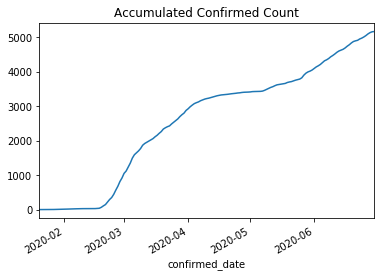

In [38]:
accumulated_count.plot()
plt.title('Accumulated Confirmed Count');

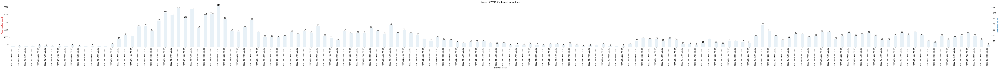

In [39]:
# 하루하루 확진자로 판명받는 데이터의 id 갯수를 세면 = 당일 확진자수가 나옵니다
daily_count = patient.groupby('confirmed_date').patient_id.count()
 
# get accumulated confirmed count
# 당일 확진자수를 모두 cumsum 합쳐서 누적확진자수를 구합니다.

accumulated_count = daily_count.cumsum()

plt.figure(figsize=(100,5))

color = 'tab:red'
ax = accumulated_count.plot(title='Korea nCOV19 Confirmed individuals', rot=90, color=color)
ax.set_ylabel('Accumulated_count', color=color)
plt.box(False)

# double-y axis graph = 하나의 그래프에 2개의 y축 사용
ax2 = ax.twinx()
color = 'tab:blue'
ax2 = daily_count.plot(kind='bar',color=color, alpha=0.1)
for p in ax2.patches:
  left, bottom, width, height = p.get_bbox().bounds
  ax2.annotate("%.f"%(height), (left+width/2, height*1.01), ha='center') # ha =horizontal align
ax2.set_ylabel('Confirmed_count', color=color)
ax2.tick_params(axis='y', color=color)

plt.box(False)
plt.show()

In [40]:
time = pd.read_csv("./Novel Corona Virus 2019 Dataset/494724_1313523_bundle_archive/covid_19_data.csv")

In [41]:
time = time[time['Country/Region']=='South Korea']

In [42]:
time = time.tail(14)

In [43]:
time.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
48237,48238,06/23/2020,NaN,South Korea,2020-06-24 04:33:28,12535.0,281.0,10930.0
48966,48967,06/24/2020,NaN,South Korea,2020-06-25 05:26:54,12563.0,282.0,10974.0
49695,49696,06/25/2020,NaN,South Korea,2020-06-26 04:33:43,12602.0,282.0,11172.0
50424,50425,06/26/2020,NaN,South Korea,2020-06-27 04:33:35,12653.0,282.0,11317.0
51153,51154,06/27/2020,NaN,South Korea,2020-06-28 04:34:04,12715.0,282.0,11364.0


#### Confrim vs Recovery vs Death

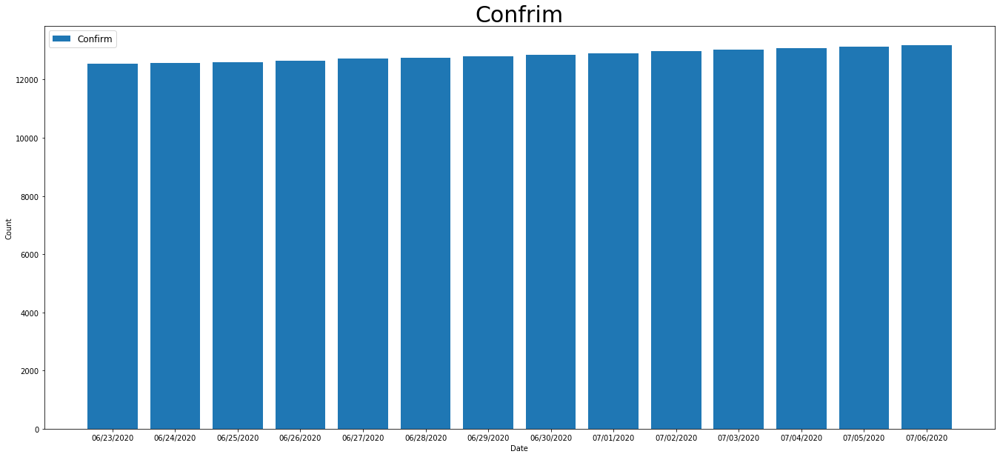

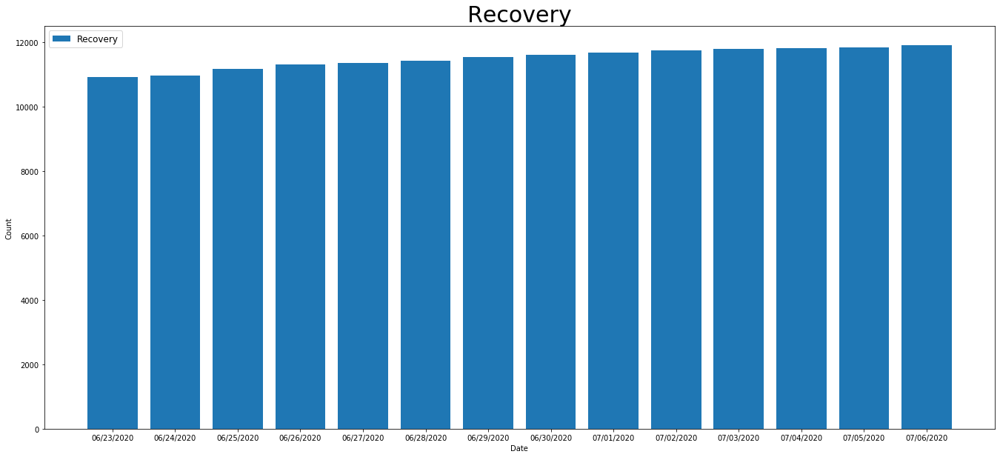

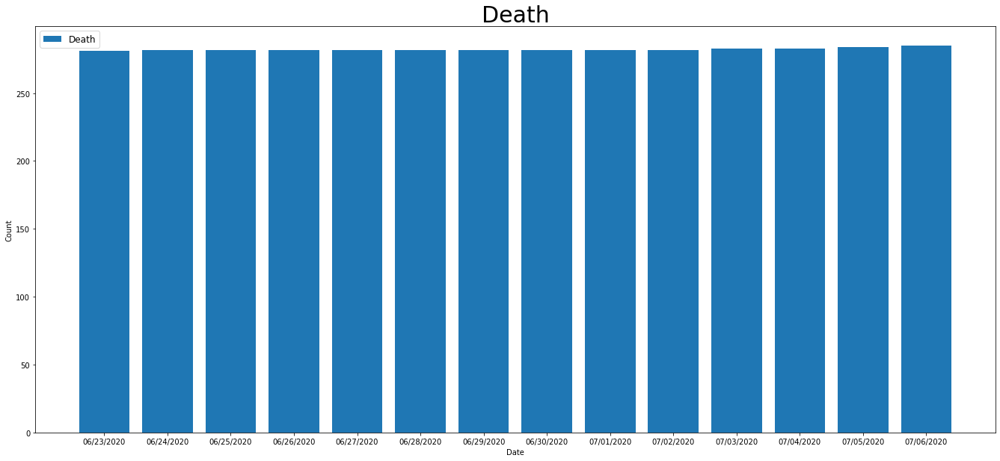

In [44]:
plt.figure(figsize=(23,10))
plt.bar(time.ObservationDate, time.Confirmed,label="Confirm")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confrim',fontsize=30)
plt.show()


plt.figure(figsize=(23,10))
plt.bar(time.ObservationDate, time.Recovered,label="Recovery")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Recovery',fontsize=30)
plt.show()

plt.figure(figsize=(23,10))

plt.bar(time.ObservationDate, time.Deaths,label="Death")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Death',fontsize=30)
plt.show()

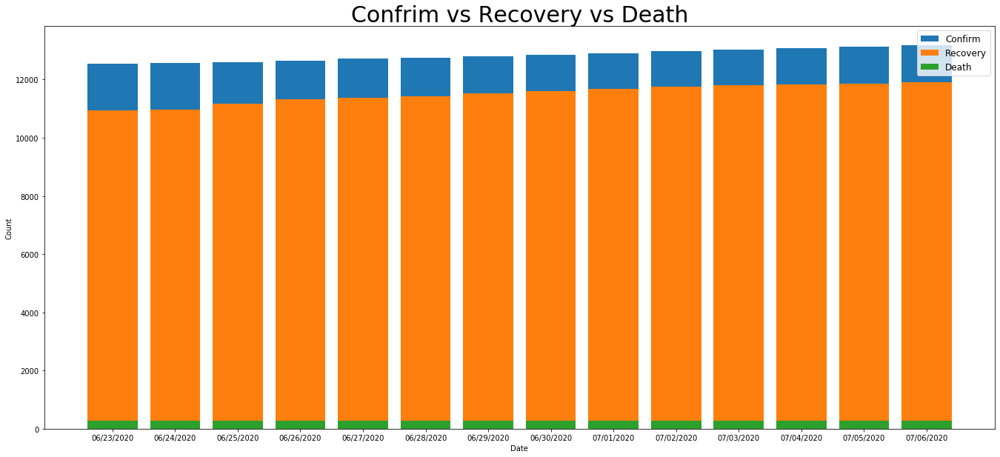

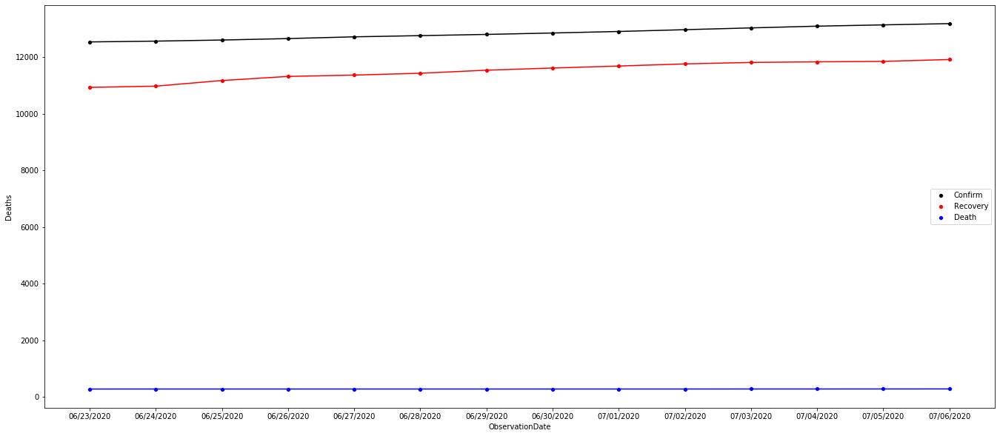

In [45]:
plt.figure(figsize=(23,10))
plt.bar(time.ObservationDate, time.Confirmed,label="Confirm")
plt.bar(time.ObservationDate, time.Recovered,label="Recovery")
plt.bar(time.ObservationDate, time.Deaths,label="Death")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confrim vs Recovery vs Death',fontsize=30)
plt.show()

f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="ObservationDate", y="Confirmed", data=time,
             color="black",label = "Confirm")
ax=sns.scatterplot(x="ObservationDate", y="Recovered", data=time,
             color="red",label = "Recovery")
ax=sns.scatterplot(x="ObservationDate", y="Deaths", data=time,
             color="blue",label = "Death")
plt.plot(time.ObservationDate,time.Confirmed,zorder=1,color="black")
plt.plot(time.ObservationDate,time.Recovered,zorder=1,color="red")
plt.plot(time.ObservationDate,time.Deaths,zorder=1,color="blue")

In [46]:
#!pip install bubbly

In [47]:
#!pip install chart_studio

In [48]:
from bubbly.bubbly import bubbleplot 
from plotly.offline import iplot
import chart_studio.plotly as py

figure = bubbleplot(dataset=time, x_column='Confirmed', y_column='Recovered', 
    bubble_column='ObservationDate',size_column='Deaths', color_column='ObservationDate', 
    x_title="Confirm", y_title="Recovered", title='Confirm vs Recovered',
     scale_bubble=3, height=650)

iplot(figure, config={'scrollzoom': True})

### Death Rate

In [49]:
from bubbly.bubbly import bubbleplot 
from plotly.offline import iplot
import chart_studio.plotly as py

figure = bubbleplot(dataset=time, x_column='Confirmed', y_column='Deaths', 
    bubble_column='ObservationDate',size_column='Deaths', color_column='ObservationDate', 
    x_title="Confirm", y_title="Deaths", title='Confirm vs Deaths',
     scale_bubble=3, height=650)

iplot(figure, config={'scrollzoom': True})

In [50]:
import plotly.offline as py

### State of person

In [51]:
Total_confirmed = time['Confirmed'].sum()
Total_recovered = time['Recovered'].sum()
Total_death = time['Deaths'].sum()
data = [['Confirmed', Total_confirmed], ['Recovered', Total_recovered], ['Death', Total_death]] 
df = pd.DataFrame(data, columns = ['state', 'count']) 
fig = px.pie(df,
             values="count",
             names="state",
             title="State of Patient",
             template="seaborn")
fig.update_traces(rotation=90, pull=0.05, textinfo="percent+label")
fig.show()

In [52]:
time['Confirmed_new'] = time['Confirmed']-time['Confirmed'].shift(1)
time['Recovered_new'] = time['Recovered']-time['Recovered'].shift(1)
time['Deaths_new'] = time['Deaths']-time['Deaths'].shift(1)

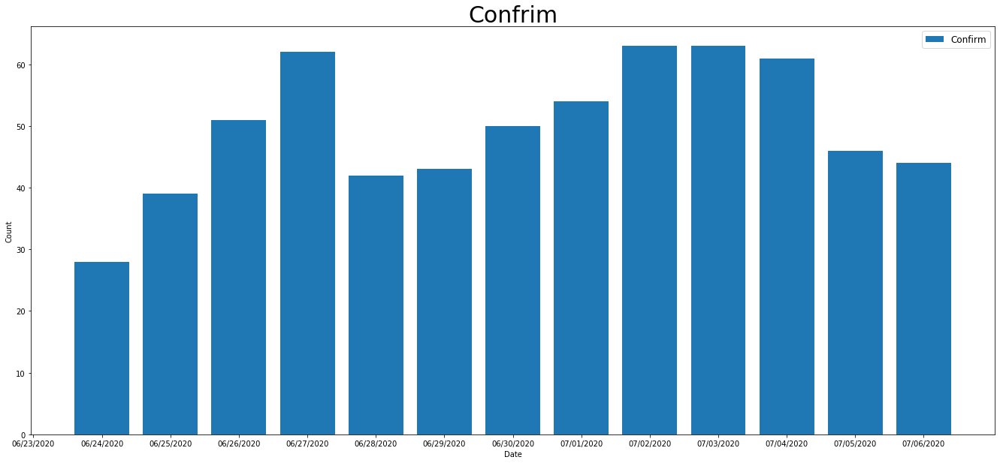

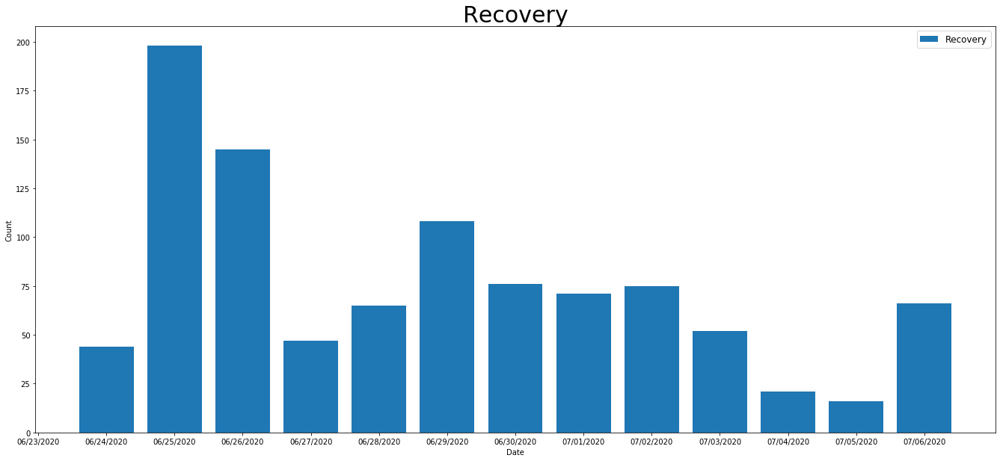

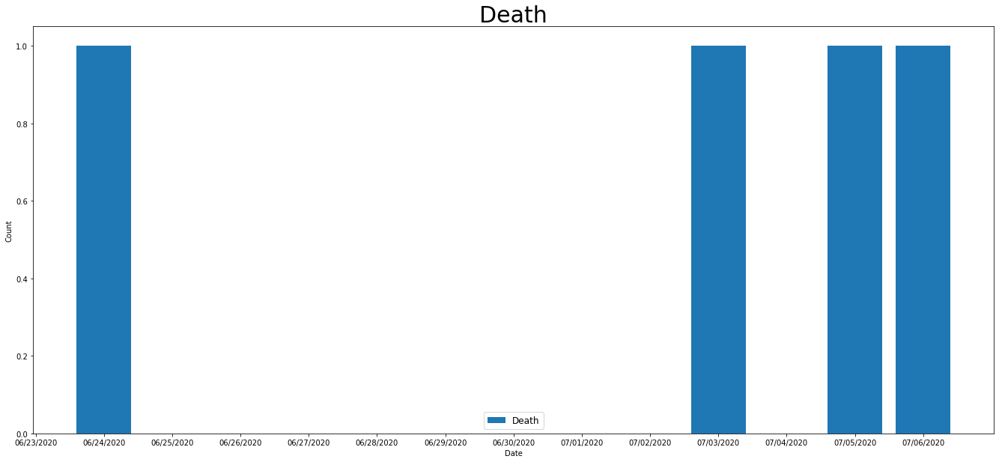

In [53]:
plt.figure(figsize=(23,10))
plt.bar(time.ObservationDate, time.Confirmed_new,label="Confirm")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confrim',fontsize=30)
plt.show()


plt.figure(figsize=(23,10))
plt.bar(time.ObservationDate, time.Recovered_new,label="Recovery")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Recovery',fontsize=30)
plt.show()

plt.figure(figsize=(23,10))

plt.bar(time.ObservationDate, time.Deaths_new,label="Death")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Death',fontsize=30)
plt.show()

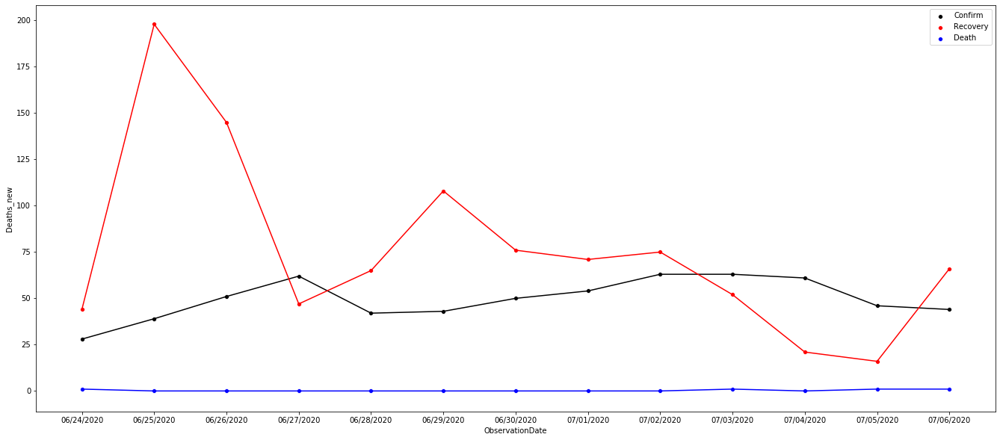

In [54]:
f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="ObservationDate", y="Confirmed_new", data=time,
             color="black",label = "Confirm")
ax=sns.scatterplot(x="ObservationDate", y="Recovered_new", data=time,
             color="red",label = "Recovery")
ax=sns.scatterplot(x="ObservationDate", y="Deaths_new", data=time,
             color="blue",label = "Death")
plt.plot(time.ObservationDate,time.Confirmed_new,zorder=1,color="black")
plt.plot(time.ObservationDate,time.Recovered_new,zorder=1,color="red")
plt.plot(time.ObservationDate,time.Deaths_new,zorder=1,color="blue")

In [55]:
global_data = time

# Reference : https://www.kaggle.com/dferhadi/logistic-curve-fitting-global-covid-19-confirmed

In [56]:
# This functions smooths data, thanks to Dan Pearson. We will use it to smooth the data for growth factor.
def smoother(inputdata,w,imax):
    data = 1.0*inputdata
    data = data.replace(np.nan,1)
    data = data.replace(np.inf,1)
    #print(data)
    smoothed = 1.0*data
    normalization = 1
    for i in range(-imax,imax+1):
        if i==0:
            continue
        smoothed += (w**abs(i))*data.shift(i,axis=0)
        normalization += w**abs(i)
    smoothed /= normalization
    return smoothed

def growth_factor(confirmed):
    confirmed_iminus1 = confirmed.shift(1, axis=0)
    confirmed_iminus2 = confirmed.shift(2, axis=0)
    return (confirmed-confirmed_iminus1)/(confirmed_iminus1-confirmed_iminus2)

def growth_ratio(confirmed):
    confirmed_iminus1 = confirmed.shift(1, axis=0)
    return (confirmed/confirmed_iminus1)

# This is a function which plots (for in input country) the active, confirmed, and recovered cases, deaths, and the growth factor.
def plot_country_active_confirmed_recovered(country):
    
    # Plots Active, Confirmed, and Recovered Cases. Also plots deaths.
    country_data = global_data[global_data['Country/Region']==country]
    table = country_data.drop(['SNo','Province/State', 'Last Update'], axis=1)
    table['ActiveCases'] = table['Confirmed'] - table['Recovered'] - table['Deaths']
    table2 = pd.pivot_table(table, values=['ActiveCases','Confirmed', 'Recovered','Deaths'], index=['ObservationDate'], aggfunc=np.sum)
    table3 = table2.drop(['Deaths'], axis=1)
   
    # Growth Factor
    w = 0.5
    table2['GrowthFactor'] = growth_factor(table2['Confirmed'])
    table2['GrowthFactor'] = smoother(table2['GrowthFactor'],w,5)

    # 2nd Derivative
    table2['2nd_Derivative'] = np.gradient(np.gradient(table2['Confirmed'])) #2nd derivative
    table2['2nd_Derivative'] = smoother(table2['2nd_Derivative'],w,7)


    #Plot confirmed[i]/confirmed[i-1], this is called the growth ratio
    table2['GrowthRatio'] = growth_ratio(table2['Confirmed'])
    table2['GrowthRatio'] = smoother(table2['GrowthRatio'],w,5)
    
    #Plot the growth rate, we will define this as k in the logistic function presented at the beginning of this notebook.
    table2['GrowthRate']=np.gradient(np.log(table2['Confirmed']))
    table2['GrowthRate'] = smoother(table2['GrowthRate'],0.5,3)
    
    # horizontal line at growth rate 1.0 for reference
    x_coordinates = [1, 100]
    y_coordinates = [1, 1]
    f, ax = plt.subplots(figsize=(15,5))
    table2['Deaths'].plot(title='Deaths')
    plt.show()
    f, ax = plt.subplots(figsize=(15,5))
    table2['GrowthFactor'].plot(title='Growth Factor')
    plt.plot(x_coordinates, y_coordinates) 
    plt.show()
    f, ax = plt.subplots(figsize=(15,5))
    table2['2nd_Derivative'].plot(title='2nd_Derivative')
    plt.show()
    f, ax = plt.subplots(figsize=(15,5))
    table2['GrowthRatio'].plot(title='Growth Ratio')
    plt.plot(x_coordinates, y_coordinates)
    plt.show()
    f, ax = plt.subplots(figsize=(15,5))
    table2['GrowthRate'].plot(title='Growth Rate')
    plt.show()

    return 

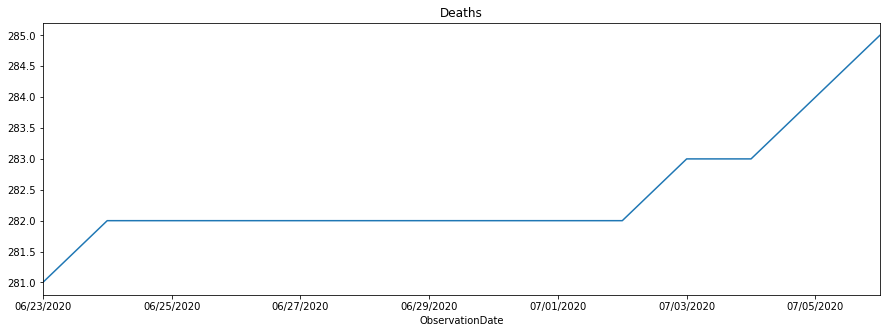

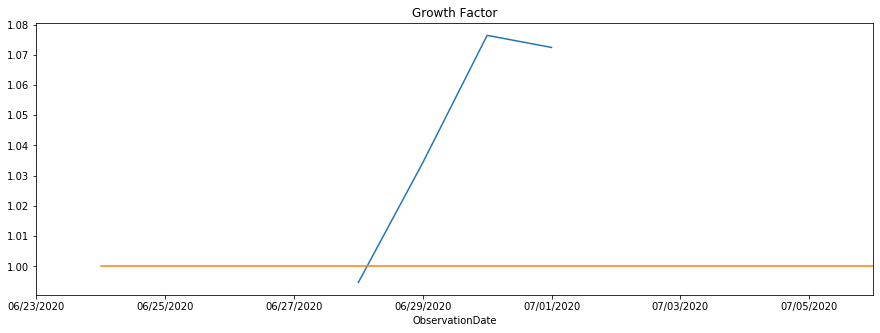

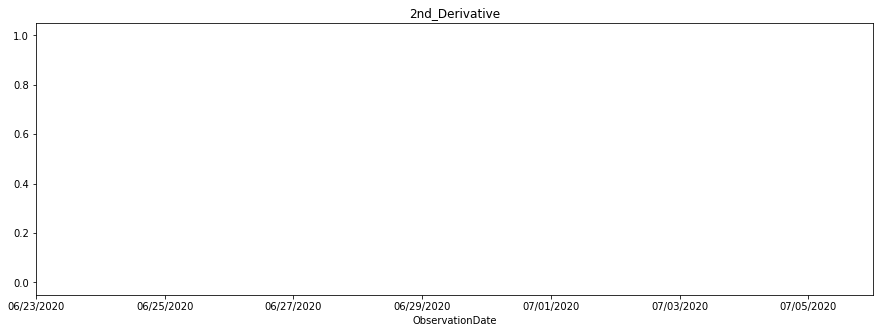

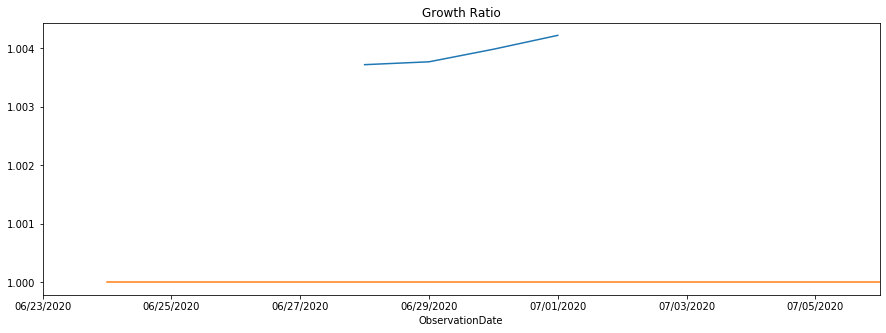

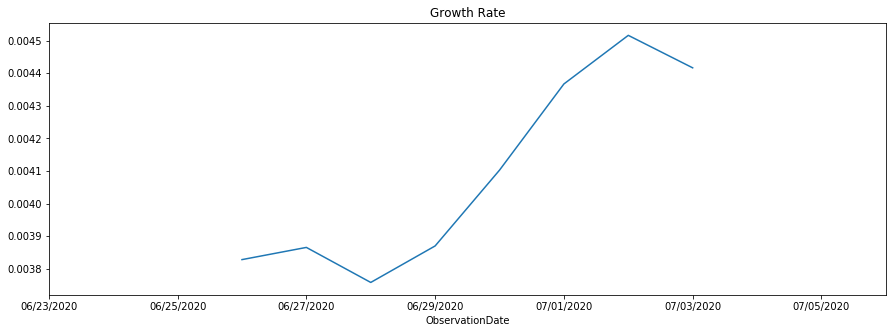

In [57]:
plot_country_active_confirmed_recovered('South Korea')

### Current State of Patient

In [58]:
infected_patient = patient.shape[0]
rp = patient.loc[patient["state"] == "released"].shape[0]
dp = patient.loc[patient["state"] == "deceased"].shape[0]
ip = patient.loc[patient["state"]== "isolated"].shape[0]
rp=rp/patient.shape[0]
dp=dp/patient.shape[0]
ip=ip/patient.shape[0]
print("The percentage of recovery is "+ str(rp*100) )
print("The percentage of deceased is "+ str(dp*100) )
print("The percentage of isolated is "+ str(ip*100) )

The percentage of recovery is 56.70861568247821
The percentage of deceased is 1.510164569215876
The percentage of isolated is 41.7812197483059


In [59]:
states = pd.DataFrame(patient["state"].value_counts())
states["status"] = states.index
states.rename(columns={"state": "count"}, inplace=True)

fig = px.pie(states,
             values="count",
             names="status",
             title="Current state of patients",
             template="seaborn")
fig.update_traces(rotation=90, pull=0.05, textinfo="value+percent+label")
fig.show()

In [60]:
released = patient[patient.state == 'released']
released.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,age_ranges,time_to_release_since_confirmed,time_to_death_since_confirmed,duration_since_confirmed,duration_days,state_by_gender
0,1000000001,male,50.0,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaT,released,50-59,13 days,NaT,13 days,13.0,released_male
1,1000000002,male,30.0,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaT,released,30-39,32 days,NaT,32 days,32.0,released_male
2,1000000003,male,50.0,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaT,released,50-59,20 days,NaT,20 days,20.0,released_male
3,1000000004,male,20.0,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaT,released,20-29,16 days,NaT,16 days,16.0,released_male
4,1000000005,female,20.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaT,released,20-29,24 days,NaT,24 days,24.0,released_female


## People who are in isolated state

In [61]:
isolated_state = patient[patient.state == 'isolated']
isolated_state.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,age_ranges,time_to_release_since_confirmed,time_to_death_since_confirmed,duration_since_confirmed,duration_days,state_by_gender
645,1000000646,NaN,NaN,Korea,Seoul,etc,Itaewon Clubs,NaN,NaN,NaN,2020-05-08,NaT,NaT,isolated,Unknown,NaT,NaT,NaT,NaN,NaN
692,1000000693,NaN,NaN,Korea,Seoul,Dongjak-gu,Itaewon Clubs,NaN,NaN,NaN,2020-05-11,NaT,NaT,isolated,Unknown,NaT,NaT,NaT,NaN,NaN
693,1000000694,NaN,NaN,Korea,Seoul,etc,Itaewon Clubs,NaN,NaN,NaN,2020-05-11,NaT,NaT,isolated,Unknown,NaT,NaT,NaT,NaN,NaN
695,1000000696,NaN,NaN,Korea,Seoul,Yongsan-gu,Itaewon Clubs,NaN,NaN,NaN,2020-05-09,NaT,NaT,isolated,Unknown,NaT,NaT,NaT,NaN,NaN
699,1000000700,male,30.0,Korea,Seoul,Yangcheon-gu,Itaewon Clubs,NaN,NaN,NaN,2020-05-11,NaT,NaT,isolated,30-39,NaT,NaT,NaT,NaN,isolated_male


## Patient who died

In [62]:
dead = patient[patient.state == 'deceased']
dead.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,age_ranges,time_to_release_since_confirmed,time_to_death_since_confirmed,duration_since_confirmed,duration_days,state_by_gender
12,1000000013,male,80.0,Korea,Seoul,Jongno-gu,contact with patient,1000000017,117,NaN,2020-02-16,NaT,NaT,deceased,80-89,NaT,NaT,NaT,NaN,deceased_male
108,1000000109,male,90.0,Korea,Seoul,etc,contact with patient,NaN,NaN,2020-03-02,2020-03-07,NaT,NaT,deceased,90-99,NaT,NaT,NaT,NaN,deceased_male
284,1000000285,male,40.0,Korea,Seoul,Mapo-gu,Guro-gu Call Center,NaN,NaN,NaN,2020-03-19,NaT,NaT,deceased,40-49,NaT,NaT,NaT,NaN,deceased_male
472,1000000473,male,60.0,Korea,Seoul,etc,contact with patient,1000000443,NaN,NaN,2020-03-31,NaT,NaT,deceased,60-69,NaT,NaT,NaT,NaN,deceased_male
996,1000000997,NaN,NaN,Korea,Seoul,Seodaemun-gu,NaN,NaN,NaN,NaN,2020-06-08,NaT,NaT,deceased,Unknown,NaT,NaT,NaT,NaN,NaN


# Age distribution of the released

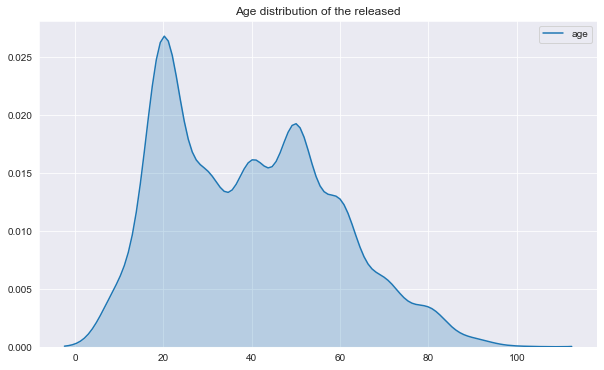

In [63]:
plt.figure(figsize=(10,6))
sns.set_style("darkgrid")
plt.title("Age distribution of the released")
sns.kdeplot(data=released['age'], shade=True)

In [64]:
patient['age_ranges']

0         50-59
1         30-39
2         50-59
3         20-29
4         20-29
5         50-59
6         20-29
7         20-29
8         30-39
9         60-69
10        50-59
11        20-29
12        80-89
13        60-69
14        70-79
15        70-79
16        70-79
17        20-29
18        70-79
19        70-79
20        80-89
21        30-39
22        50-59
23        40-49
24        60-69
25        30-39
26        50-59
27        70-79
28        20-29
29        60-69
         ...   
5135      20-29
5136      40-49
5137      40-49
5138      10-19
5139      40-49
5140      40-49
5141      40-49
5142    Unknown
5143      40-49
5144      30-39
5145      30-39
5146      20-29
5147      20-29
5148      40-49
5149      40-49
5150      20-29
5151      30-39
5152      20-29
5153      10-19
5154      20-29
5155      20-29
5156      30-39
5157      20-29
5158      10-19
5159      30-39
5160      30-39
5161    Unknown
5162    Unknown
5163    Unknown
5164    Unknown
Name: age_ranges, Length

In [65]:
agr = released[released.age_ranges!="Unknown"]
fig = px.pie(agr,
             names="age_ranges",
             title="Age of released person",
             template="seaborn")
fig.update_traces(rotation=90, pull=0.05, textinfo="percent+label")
fig.show()

### Age distribution of isolated person

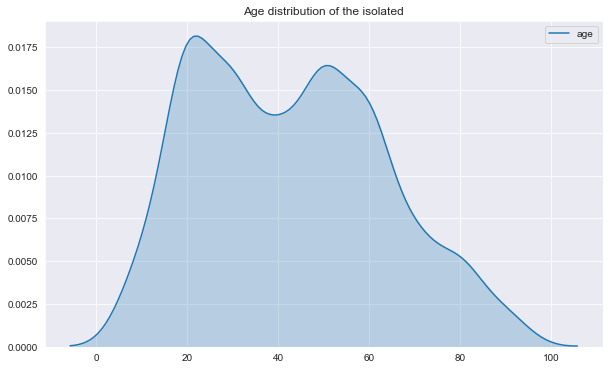

In [66]:
plt.figure(figsize=(10,6))
sns.set_style("darkgrid")
plt.title("Age distribution of the isolated")
sns.kdeplot(data=isolated_state['age'], shade=True)

In [67]:
agi = isolated_state[isolated_state.age_ranges!="Unknown"]
fig = px.pie(agi,
             names="age_ranges",
             title="Age of isolated person",
             template="seaborn")
fig.update_traces(rotation=90, pull=0.05, textinfo="percent+label")
fig.show()

### Age distribution of death

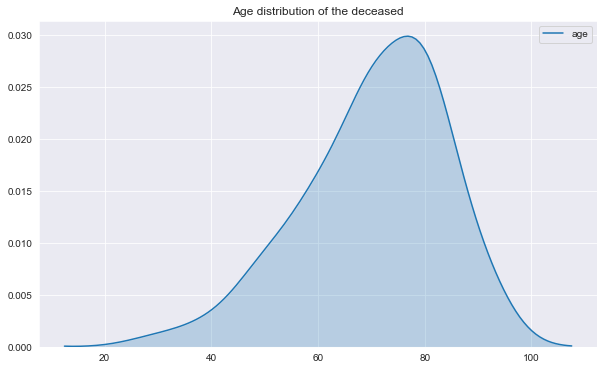

In [68]:
plt.figure(figsize=(10,6))
sns.set_style("darkgrid")
plt.title("Age distribution of the deceased")
sns.kdeplot(data=dead['age'], shade=True)

In [69]:
agd = dead[dead.age_ranges!="Unknown"]
fig = px.pie(agd,
             names="age_ranges",
             title="Age of Dead person",
             template="seaborn")
fig.update_traces(rotation=90, pull=0.05, textinfo="percent+label")
fig.show()

    ** Age distribution of deceased **
Here, the graph shows the age distribution of the deceased by gender. We can clearly see older people are more likely to be infected, especially older people with underlying lung disease and having problems in their respiration. The age group of 60 to 70 yr are more infected than the rest of the population. As Dr. Steven Gambert, professor of medicine and director of geriatrics at the University of Maryland School of Medicine says “ Older people have higher risk of underlying health conditions, older people are already under physical stress, and their immune systems, even if not significantly compromised, simply do not have the same “ability to fight viruses and bacteria”

In [70]:
male_dead = dead[dead.sex=='male']
female_dead = dead[dead.sex=='female']

### Age distribution of death by gender

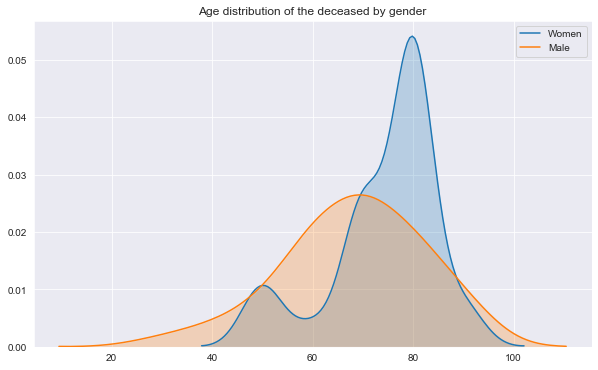

In [71]:
plt.figure(figsize=(10,6))
sns.set_style("darkgrid")
plt.title("Age distribution of the deceased by gender")
sns.kdeplot(data=female_dead['age'], label="Women", shade=True)
sns.kdeplot(data=male_dead['age'],label="Male" ,shade=True)

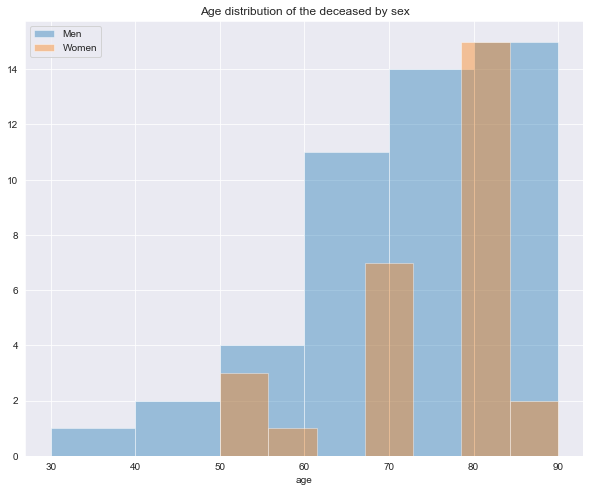

In [72]:
plt.figure(figsize=(10,8))
sns.set_style("darkgrid")
sns.distplot(a=male_dead['age'], label="Men", kde=False)
sns.distplot(a=female_dead['age'], label="Women", kde=False)
plt.title("Age distribution of the deceased by sex")
plt.legend()

  **Gender distribution of deceased **
The graph shows the age distribution of deceased gender where men are more likely to die from coronavirus than women. New research has found that men, particularly middle-aged and older men, are having a harder time fighting off the virus than women. Chinese researchers found that while the infection rate among men and women is the same, the death rate among men is 2.8% compared with 1.7% for women. As there are a few reasons men are more likely to die from the new coronavirus. Women have a heightened immune response. During Middle East respiratory syndrome coronavirus 32% of men died of the infection compared with 25.8% of women.

### Comparison of released and deceased by age

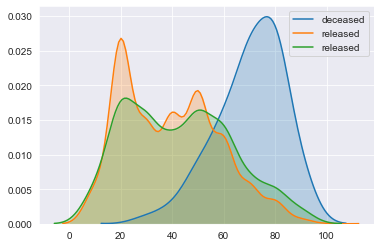

In [73]:
sns.kdeplot(data=dead['age'],label='deceased', shade=True)
sns.kdeplot(data=released['age'],label='released', shade=True)
sns.kdeplot(data=isolated_state['age'],label='released', shade=True)

### Death by gender

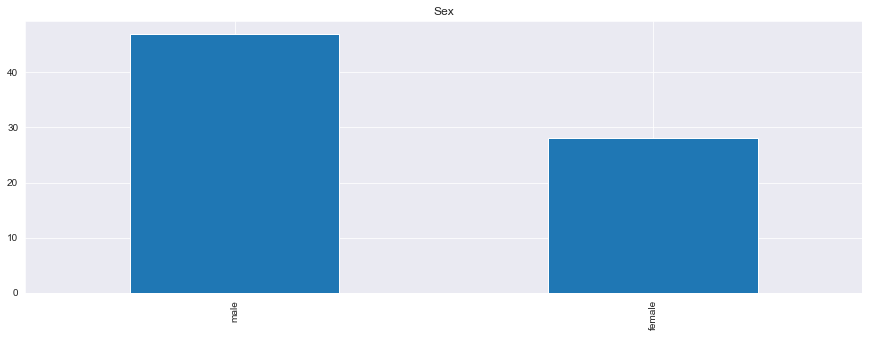

In [74]:
plt.figure(figsize=(15, 5))
plt.title('Sex')
dead.sex.value_counts().plot.bar();

In [75]:
fig = px.pie( values=dead.groupby(['sex']).size().values,names=dead.groupby(['sex']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

# Isolation by gender

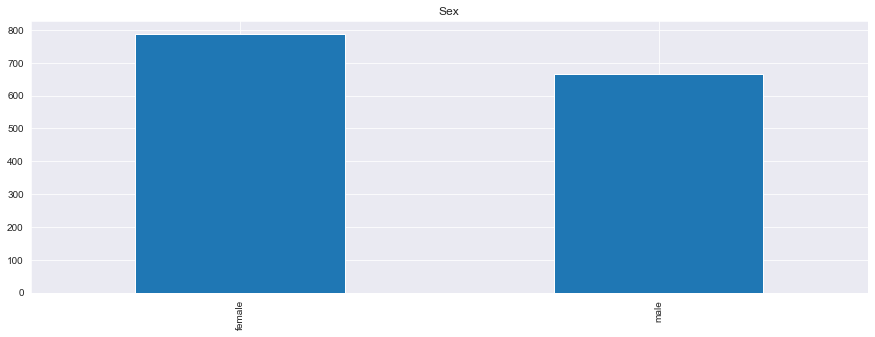

In [76]:
plt.figure(figsize=(15, 5))
plt.title('Sex')
isolated_state.sex.value_counts().plot.bar();

In [77]:
fig = px.pie( values=isolated_state.groupby(['sex']).size().values,names=isolated_state.groupby(['sex']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

### Recovery by gender

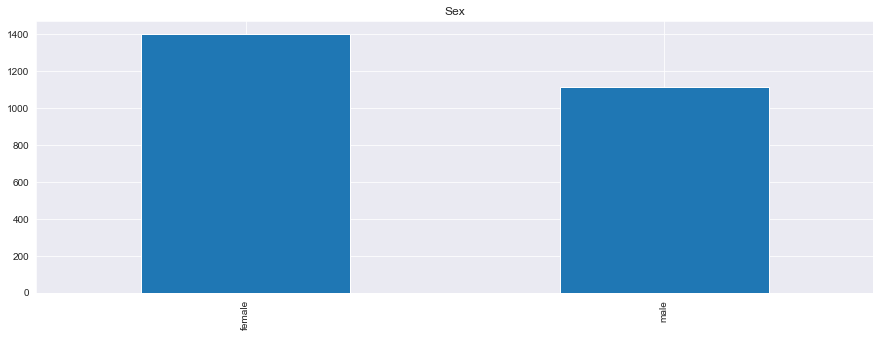

In [78]:
plt.figure(figsize=(15, 5))
plt.title('Sex')
released.sex.value_counts().plot.bar();

In [79]:
fig = px.pie( values=released.groupby(['sex']).size().values,names=released.groupby(['sex']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

### Reason for the infection

In [80]:
patient

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,age_ranges,time_to_release_since_confirmed,time_to_death_since_confirmed,duration_since_confirmed,duration_days,state_by_gender
0,1000000001,male,50.0,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaT,released,50-59,13 days,NaT,13 days,13.0,released_male
1,1000000002,male,30.0,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaT,released,30-39,32 days,NaT,32 days,32.0,released_male
2,1000000003,male,50.0,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaT,released,50-59,20 days,NaT,20 days,20.0,released_male
3,1000000004,male,20.0,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaT,released,20-29,16 days,NaT,16 days,16.0,released_male
4,1000000005,female,20.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaT,released,20-29,24 days,NaT,24 days,24.0,released_female
5,1000000006,female,50.0,Korea,Seoul,Jongno-gu,contact with patient,1000000003,43,NaN,2020-01-31,2020-02-19,NaT,released,50-59,19 days,NaT,19 days,19.0,released_female
6,1000000007,male,20.0,Korea,Seoul,Jongno-gu,contact with patient,1000000003,0,NaN,2020-01-31,2020-02-10,NaT,released,20-29,10 days,NaT,10 days,10.0,released_male
7,1000000008,male,20.0,Korea,Seoul,etc,overseas inflow,NaN,0,NaN,2020-02-02,2020-02-24,NaT,released,20-29,22 days,NaT,22 days,22.0,released_male
8,1000000009,male,30.0,Korea,Seoul,Songpa-gu,overseas inflow,NaN,68,NaN,2020-02-05,2020-02-21,NaT,released,30-39,16 days,NaT,16 days,16.0,released_male
9,1000000010,female,60.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000003,6,NaN,2020-02-05,2020-02-29,NaT,released,60-69,24 days,NaT,24 days,24.0,released_female


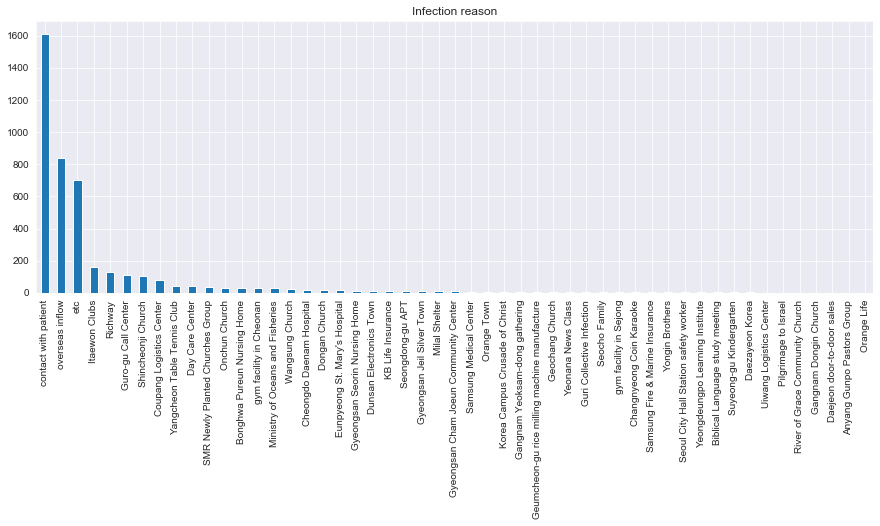

In [81]:
plt.figure(figsize=(15,5))
plt.title('Infection reason')
patient.infection_case.value_counts().plot.bar();

In [82]:
fig = px.pie( values=patient.groupby(['infection_case']).size().values,names=patient.groupby(['infection_case']).size().index)
fig.update_layout(
    font=dict(
        size=10,
        color="#242323"
    )
    )   
    
py.iplot(fig)

In [83]:
inf_rsn =  patient['infection_case']
inf_rsn  = inf_rsn.dropna()

<Figure size 720x432 with 0 Axes>

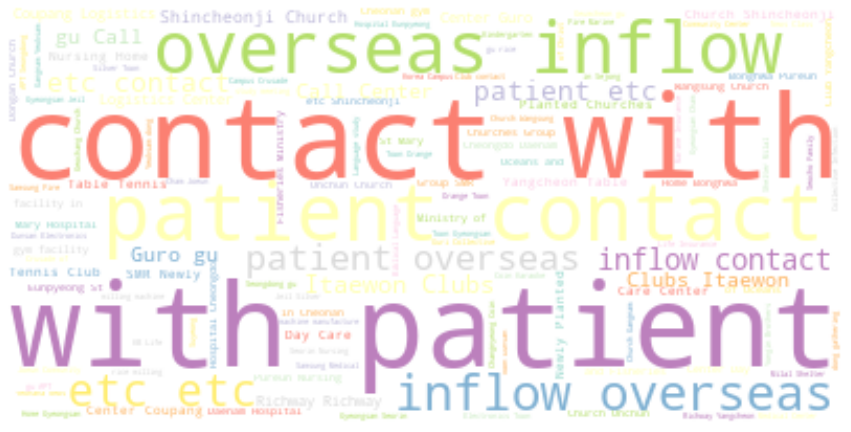

In [84]:
from wordcloud import WordCloud, ImageColorGenerator
text = " ".join(str(each) for each in inf_rsn)
wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="white").generate(text)
plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='Bilinear')
plt.axis("off")
plt.figure(1,figsize=(12, 12))
plt.show()

There are many effective reasons for the coronavirus infection. There is no specific antiviral treatment recommended for COVID-19. People with COVID-19 should receive supportive care to help relieve symptoms. For severe cases, treatment should include care to support vital organ functions.People who think they may have been exposed to COVID-19 should contact their healthcare provider immediately. According to the dataset the major reason for the infection is being in contact with patients. There are so many different reasons for the cause of infection which are visits to countries and regions like daegu, wuhan, thailand, china, vietnam, italy.

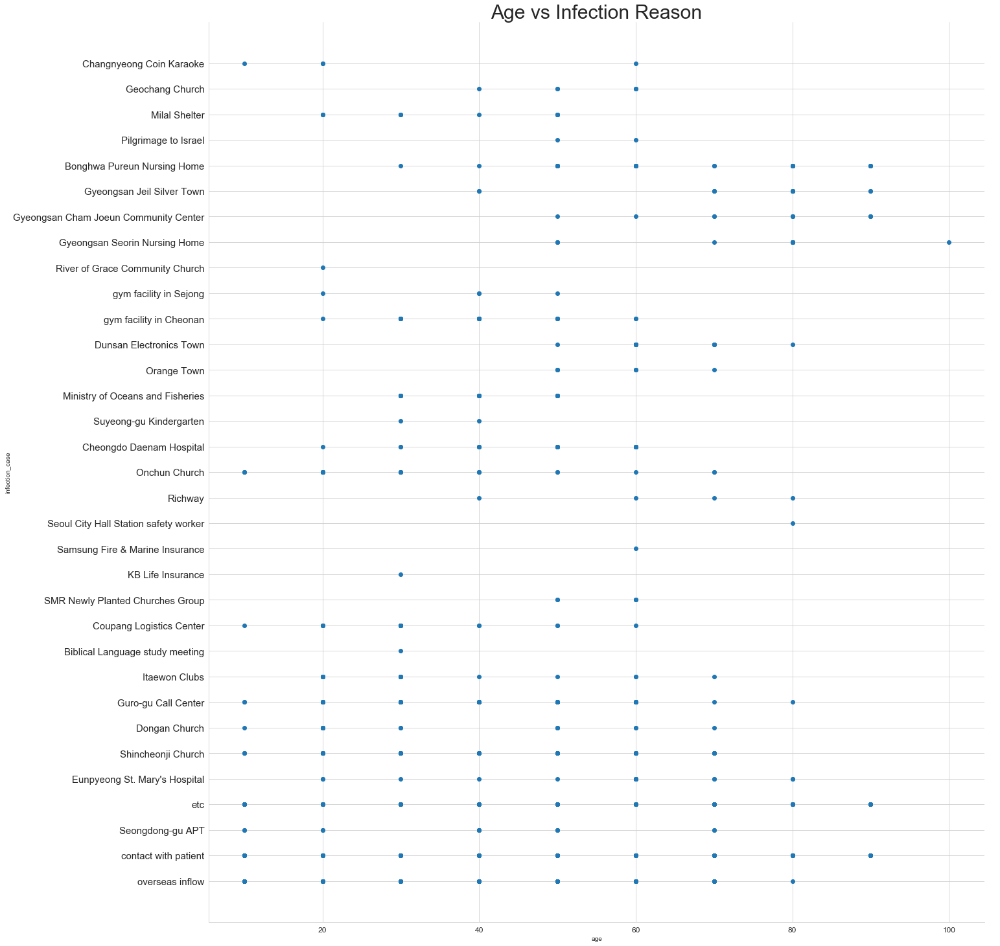

In [85]:
sns.set_style("whitegrid")
sns.FacetGrid(patient,  size = 20).map(plt.scatter, 'age', 'infection_case').add_legend()
plt.title('Age vs Infection Reason',fontsize=30)
plt.xticks(fontsize=12)
plt.yticks(fontsize=15)
plt.show()

### State of Patient

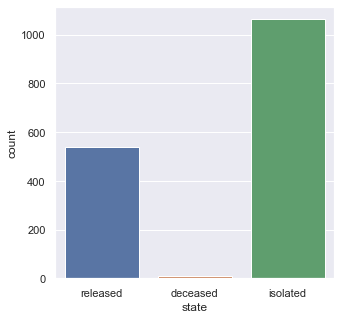

In [86]:
sns.set(rc={'figure.figsize':(5,5)})
sns.countplot(x=patient['state'].loc[
    (patient['infection_case']=='contact with patient')
])

In [87]:
fig = px.pie( values=patient.groupby(['state']).size().values,names=patient.groupby(['state']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

### State of male patient

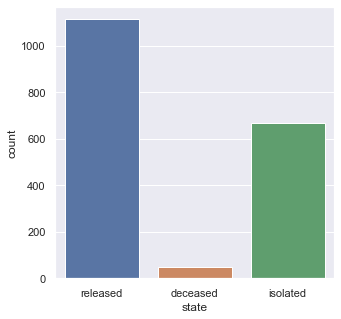

In [88]:
sns.set(rc={'figure.figsize':(5,5)})
sns.countplot(x=patient['state'].loc[(patient['sex']=="male")])

### State of female patient

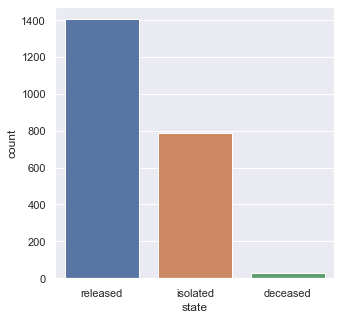

In [89]:
sns.set(rc={'figure.figsize':(5,5)})
sns.countplot(x=patient['state'].loc[(patient['sex']=="female")])

The first case of coronavirus in the country on January 20. At the moment, 31 patients were discharged from hospitals after making a full recovery from the virus and 22 deaths are reported. In total, over 105 thousand people have been tested until now.

### State of patient(male and female) vs age

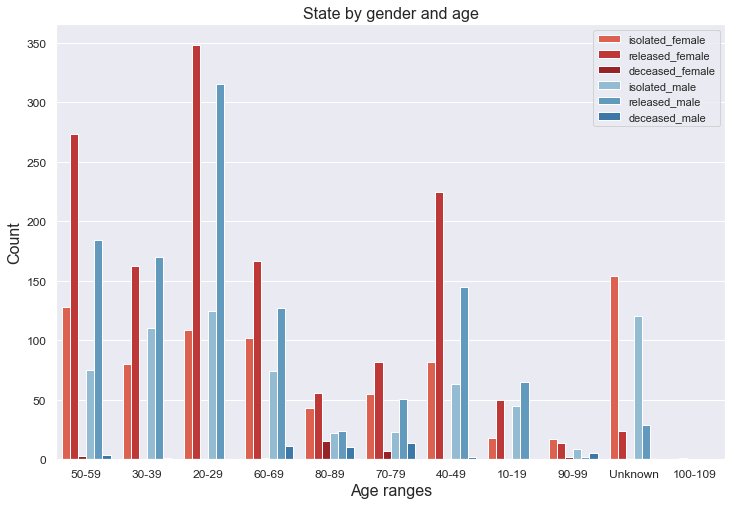

In [90]:
age_gender_hue_order =["isolated_female", "released_female", "deceased_female",
                       "isolated_male", "released_male", "deceased_male"]
custom_palette = sns.color_palette("Reds")[3:6] + sns.color_palette("Blues")[2:5]

plt.figure(figsize=(12, 8))
sns.countplot(x = "age_ranges",
              hue="state_by_gender",
              hue_order=age_gender_hue_order,
              palette=custom_palette,
              data=patient)
plt.title("State by gender and age", fontsize=16)
plt.xlabel("Age ranges", fontsize=16)
plt.ylabel("Count", fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(loc="upper right")
plt.show()

### Region by age and state

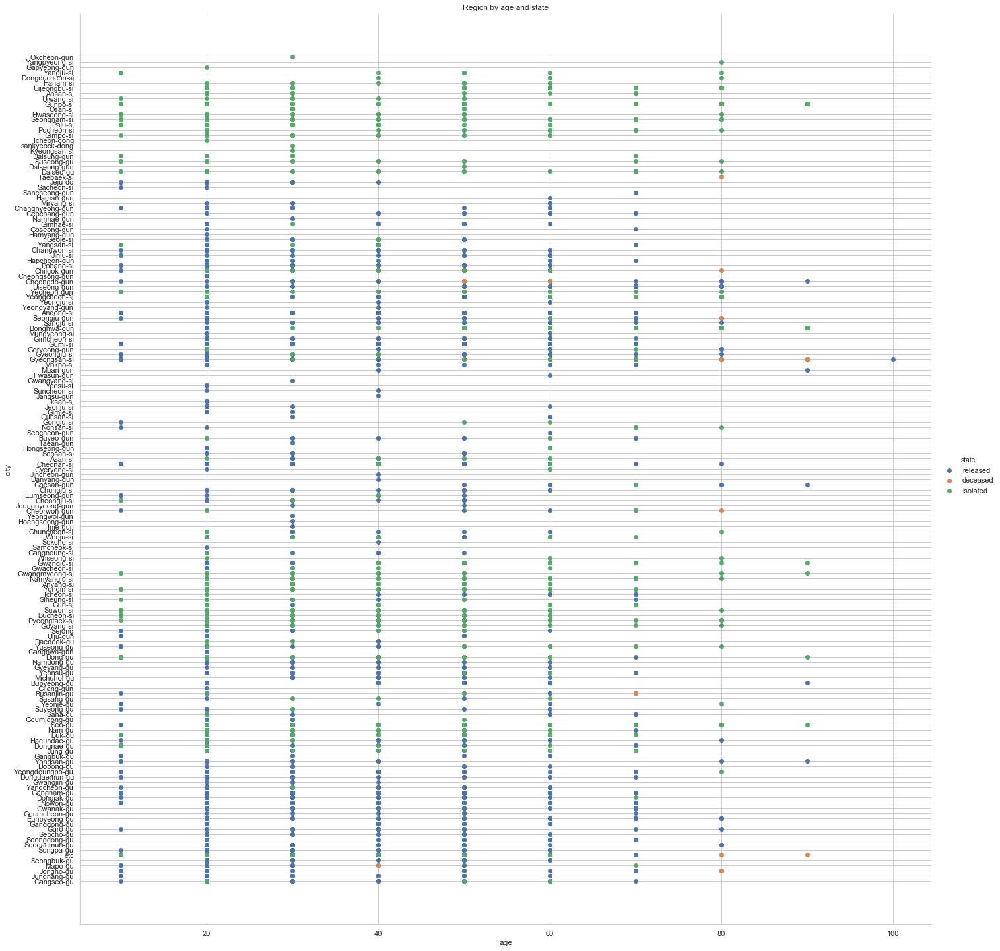

In [91]:
sns.set_style("whitegrid")
sns.FacetGrid(patient, hue = 'state', size = 20)\
.map(plt.scatter, 'age', 'city')\
.add_legend()
plt.title('Region by age and state')
plt.show()

### Looking route data

In [92]:
route.head()

,patient_id,date,province,city,type,latitude,longitude
0,1000000001,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.61525,126.7156
1,1000000001,2020-01-24,Seoul,Jung-gu,hospital,37.56724,127.0057
2,1000000002,2020-01-25,Seoul,Seongbuk-gu,etc,37.59256,127.0170
3,1000000002,2020-01-26,Seoul,Seongbuk-gu,store,37.59181,127.0168
4,1000000002,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.56399,127.0295


In [93]:
route.isna().sum()

patient_id    0
date          0
province      0
city          0
type          0
latitude      0
longitude     0
dtype: int64

### We will verify our clusters by putting values in world map by making use of folium library

### Affected place in world map

In [94]:
import folium
southkorea_map = folium.Map(location=[36.55,126.983333 ], zoom_start=7,tiles='Stamen Toner')

for lat, lon,city in zip(route['latitude'],route['longitude'],route['city']):
    folium.CircleMarker([lat, lon],
                        radius=5,
                        color='red',
                      popup =('City: ' + str(city) + '<br>'),
                        fill_color='red',
                        fill_opacity=0.7 ).add_to(southkorea_map)
southkorea_map

In [95]:
cmap1 = route
cmap1  = cmap1.groupby(['date', 'province','latitude','longitude'])['patient_id'].max()


cmap1 = cmap1.reset_index()
cmap1.head()
cmap1['size'] = cmap1['patient_id']*900
cmap1
fig = px.scatter_mapbox(cmap1, lat="latitude", lon="longitude",
                     color="patient_id", size='size',
                     color_continuous_scale='burgyl',
                     animation_frame="date", 
                     title='Spread total cases over time')
fig.update(layout_coloraxis_showscale=True)
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3)
fig.update_layout(margin={"r":0,"t":30,"l":0,"b":0})
fig.show()

On the world map it can clearly be seen that the western side of the country is more affected. The number of cases from Daegu and Gyeongbuk accounts for almost 88 percent of the total infections. This is closely linked to a religious group called Shincheonji Church of Jesus based in Daegu, where a collective infection has occurred and is spreading throughout the country. About 60 percent of all infections in South Korea were related to Shincheonji. There have also been several deaths from a hospital linked to this religious group. The government of South Korea announced that it will test all over 200 thousand members of the group for the coronavirus. Over 70 countries are restricting entry from South korea. South Korea has the most cases after China. South Korea reported the first case on 19th of feb.The cases increased multifold on 21 February, the majority of them being reported in the city of Daegu. The increase was due to community spread, traced to a church in Shincheonji, alarming the Korean health authorities. Singapore too is facing a similar surge in community spread of the novel coronavirus. Seoul city mayor Park Won-soon demanded to prosecute some of the key leaders of the Shincheonji Church for hiding the identities of the suspects during contact tracing investigation.The alert level was further raised to Orange (Level 3) on 28 January. Furthermore, 29 national designated hospitals were announced to isolate the confirmed and suspected cases

## Patient in city

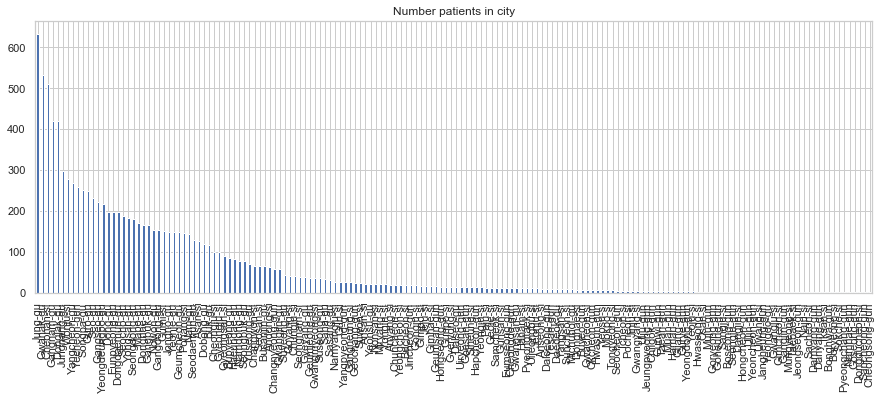

In [96]:
plt.figure(figsize=(15,5))
plt.title('Number patients in city')
route.city.value_counts().plot.bar();

In [97]:
fig = px.pie( values=route.groupby(['city']).size().values,names=route.groupby(['city']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

<Figure size 720x432 with 0 Axes>

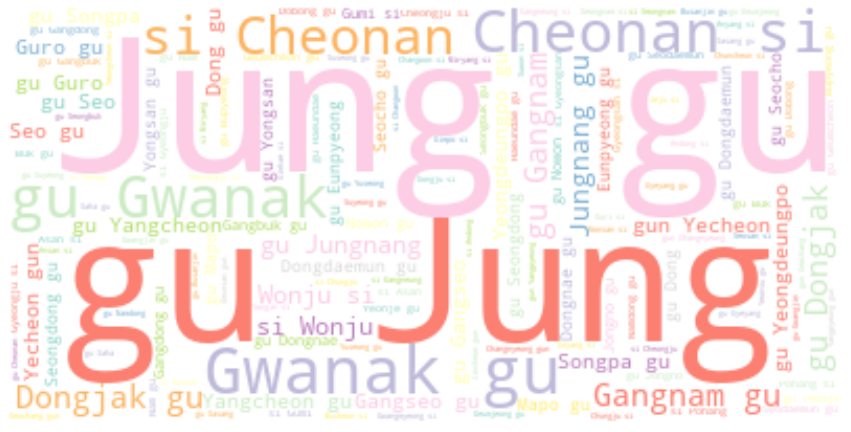

In [98]:
from wordcloud import WordCloud, ImageColorGenerator
text = " ".join(str(each) for each in route.city)
wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="white").generate(text)
plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='Bilinear')
plt.axis("off")
plt.figure(1,figsize=(12, 12))
plt.show()


### Patients in Provience/State

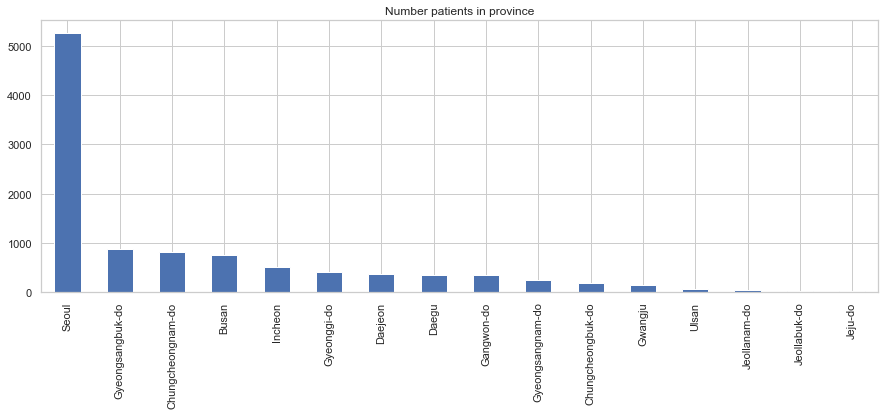

In [99]:
plt.figure(figsize=(15,5))
plt.title('Number patients in province')
route.province.value_counts().plot.bar();

In [100]:
fig = px.pie( values=route.groupby(['province']).size().values,names=route.groupby(['province']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

<Figure size 720x432 with 0 Axes>

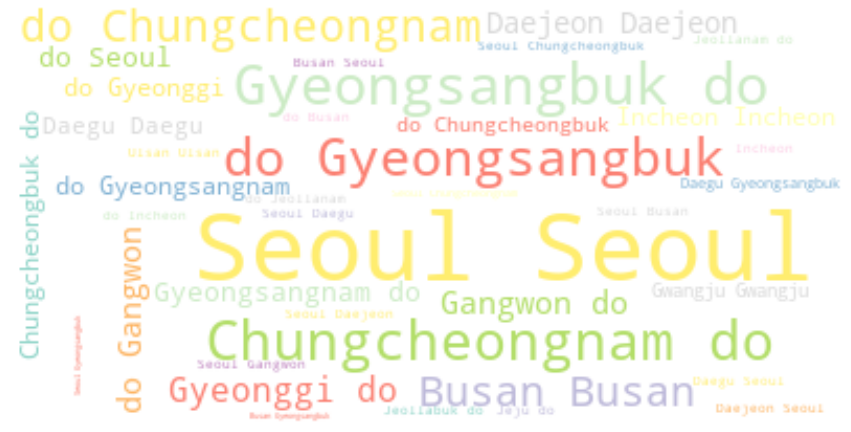

In [101]:
from wordcloud import WordCloud, ImageColorGenerator
text = " ".join(str(each) for each in route.province)
wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="white").generate(text)
plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='Bilinear')
plt.axis("off")
plt.figure(1,figsize=(12, 12))
plt.show()

### Places where people get affected

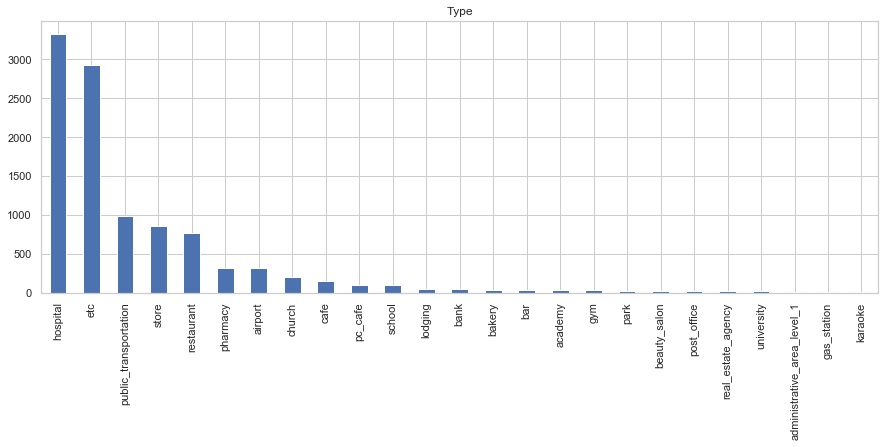

In [102]:
plt.figure(figsize=(15,5))
plt.title('Type')
route.type.value_counts().plot.bar();

In [103]:
fig = px.pie( values=route.groupby(['type']).size().values,names=route.groupby(['type']).size().index)
fig.update_layout(
    font=dict(
        size=15,
        color="#242323"
    )
    )   
    
py.iplot(fig)

<Figure size 720x432 with 0 Axes>

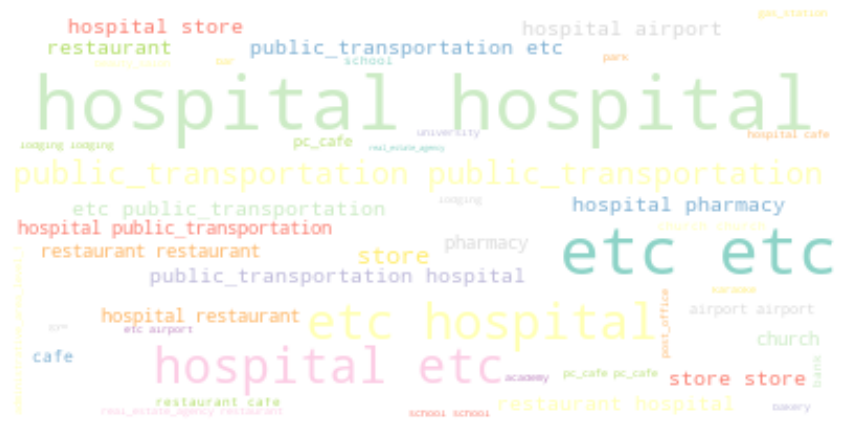

In [104]:
from wordcloud import WordCloud, ImageColorGenerator
text = " ".join(str(each) for each in route.type)
wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="white").generate(text)
plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='Bilinear')
plt.axis("off")
plt.figure(1,figsize=(12, 12))
plt.show()

In [105]:
fig = px.treemap(route, path=["type",'province','city'],
                  color='province', hover_data=['type'],
                  color_continuous_scale='rainbow')
fig.show()

### Time from confirmation to release or death

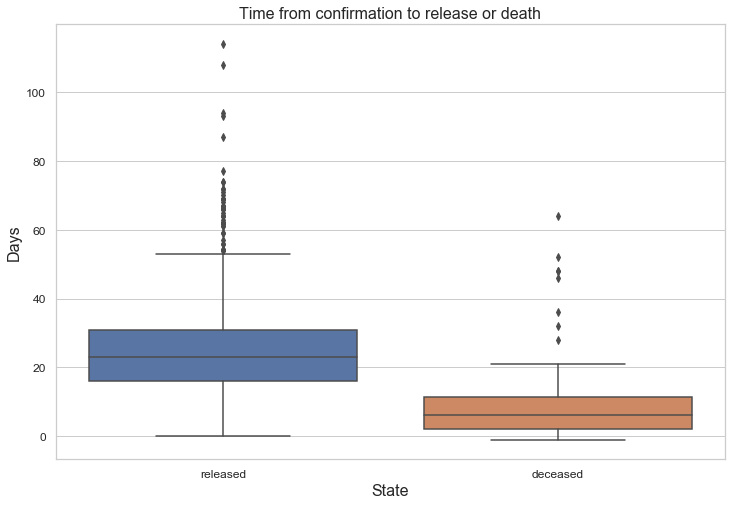

In [106]:
plt.figure(figsize=(12, 8))
sns.boxplot(x="state",
            y="duration_days",
            order=["released", "deceased"],
            data=patient)
plt.title("Time from confirmation to release or death", fontsize=16)
plt.xlabel("State", fontsize=16)
plt.ylabel("Days", fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

### Time from confirmation to release or death by gender

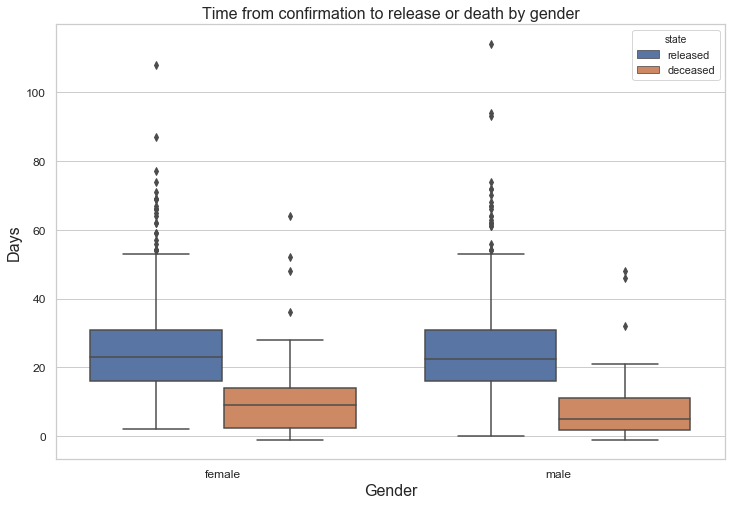

In [107]:
order_duration_sex = ["female", "male"]
plt.figure(figsize=(12, 8))
sns.boxplot(x="sex",
            y="duration_days",
            order=order_duration_sex,
            hue="state",            
            hue_order=["released", "deceased"],
            data=patient)
plt.title("Time from confirmation to release or death by gender",
          fontsize=16)
plt.xlabel("Gender", fontsize=16)
plt.ylabel("Days", fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

### Time from confirmation to release or death

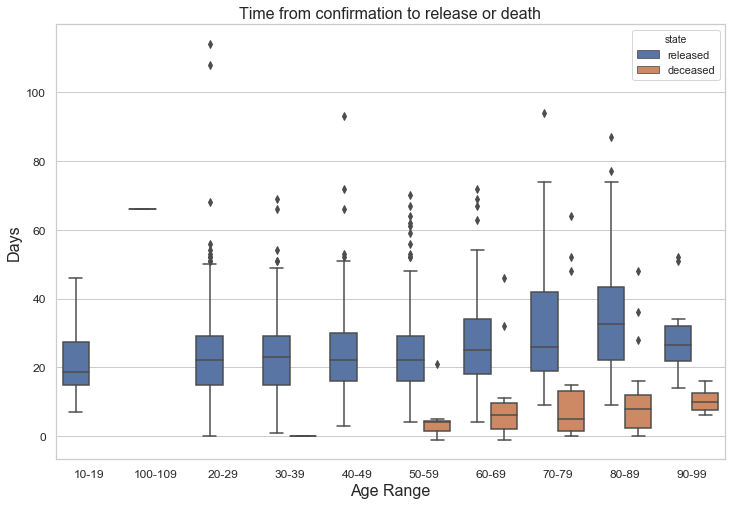

In [108]:
order_duration_age = sorted(patient["age_ranges"].unique())[:-1]
plt.figure(figsize=(12, 8))
sns.boxplot(x="age_ranges",
            y="duration_days",
            order=order_duration_age,
            hue="state",
            hue_order=["released", "deceased"],
            data=patient)
plt.title("Time from confirmation to release or death", fontsize=16)
plt.xlabel("Age Range", fontsize=16)
plt.ylabel("Days", fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

As the suspects of coronavirus are kept under observation. After the observation it has been found that the people who are released or who have great chances of recovery had sustained 10-20 days in hospitals. On the other hand the people who are deceased were found dead in 0-4 days.The deadly Coronavirus which has spread to more than 70 countries, is wreaking havoc globally, killing over 3,000 people and infecting almost 90,000 people since first detected in China in December last year. While Australia and the US reported their first deaths yesterday,

# 2. Machine learning

### linear regression

### Regularized Linear Regression

## https://ratsgo.github.io/machine%20learning/2017/05/22/RLR/

## ordinary least square

In [109]:
daily_count = patient.groupby('confirmed_date').patient_id.count()
daily_count = pd.DataFrame(daily_count).cumsum()
data = daily_count
data 

,patient_id
confirmed_date,
2020-01-20,1
2020-01-23,2
2020-01-26,3
2020-01-27,4
2020-01-30,8
2020-01-31,11
2020-02-01,12
2020-02-02,15
2020-02-03,16


In [110]:
dataset = data.iloc[15:138]
print(len(dataset)) # 2020년 5월 4일 데이터 없음 

123


In [111]:
# Future forcasting
days_in_future = 10


dates1 = pd.date_range('2020-2-18','2020-5-3')
dates2 = pd.date_range('2020-5-5', '2020-6-20')
dates1 = pd.DataFrame(dates1)
dates2 = pd.DataFrame(dates2)
dates = [dates1, dates2]
dates = pd.concat(dates, axis = 0)


future_forecast = np.array([i+1 for i in range(len(dates)+days_in_future)]).reshape(-1, 1)
# future_forcast #10일을 추가해서 > 미래 10일의 그래프를 그려본다.

days = np.array([i for i in range(len(dates))]).reshape(-1, 1) # index -> ndarray, -1해준 이유 인덱스는 마지막을 생각해 주지 않음..
datas = np.array(dataset).reshape(-1, 1) # count->ndarray

In [112]:
data['patient_id']

confirmed_date
2020-01-20       1
2020-01-23       2
2020-01-26       3
2020-01-27       4
2020-01-30       8
2020-01-31      11
2020-02-01      12
2020-02-02      15
2020-02-03      16
2020-02-05      21
2020-02-06      23
2020-02-07      24
2020-02-09      27
2020-02-10      28
2020-02-16      30
2020-02-18      39
2020-02-19      67
2020-02-20     109
2020-02-21     146
2020-02-22     218
2020-02-23     293
2020-02-24     350
2020-02-25     443
2020-02-26     565
2020-02-27     677
2020-02-28     814
2020-02-29     917
2020-03-01    1050
2020-03-02    1118
2020-03-03    1231
              ... 
2020-06-01    4093
2020-06-02    4137
2020-06-03    4170
2020-06-04    4209
2020-06-05    4262
2020-06-06    4314
2020-06-07    4342
2020-06-08    4380
2020-06-09    4430
2020-06-10    4468
2020-06-11    4512
2020-06-12    4561
2020-06-13    4599
2020-06-14    4624
2020-06-15    4648
2020-06-16    4688
2020-06-17    4738
2020-06-18    4780
2020-06-19    4832
2020-06-20    4873
2020-06-21    48

In [113]:
print(data['patient_id'][15:138][2])

109


In [114]:
real_data = []
for i in range(len(data['patient_id'][15:138])):
    real_data.append(data['patient_id'][15:138][i])
print(real_data)

[39, 67, 109, 146, 218, 293, 350, 443, 565, 677, 814, 917, 1050, 1118, 1231, 1347, 1492, 1591, 1648, 1702, 1771, 1866, 1917, 1952, 1987, 2021, 2058, 2111, 2155, 2212, 2262, 2335, 2373, 2404, 2427, 2484, 2531, 2580, 2629, 2696, 2751, 2797, 2875, 2923, 2982, 3030, 3073, 3100, 3122, 3156, 3180, 3203, 3219, 3231, 3249, 3266, 3286, 3300, 3311, 3324, 3329, 3336, 3342, 3352, 3359, 3364, 3372, 3381, 3386, 3396, 3402, 3403, 3407, 3411, 3420, 3423, 3425, 3428, 3436, 3458, 3488, 3515, 3543, 3564, 3593, 3617, 3627, 3637, 3644, 3658, 3685, 3700, 3711, 3733, 3753, 3770, 3784, 3821, 3898, 3955, 3992, 4015, 4047, 4093, 4137, 4170, 4209, 4262, 4314, 4342, 4380, 4430, 4468, 4512, 4561, 4599, 4624, 4648, 4688, 4738, 4780, 4832, 4873]


In [115]:
import statsmodels.api as sm

lm= sm.OLS(days,datas)
results =lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.961
Model:                            OLS   Adj. R-squared (uncentered):              0.960
Method:                 Least Squares   F-statistic:                              2982.
Date:                Fri, 07 Aug 2020   Prob (F-statistic):                    1.35e-87
Time:                        18:41:32   Log-Likelihood:                         -499.07
No. Observations:                 123   AIC:                                      1000.
Df Residuals:                     122   BIC:                                      1003.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0215      0.000     54.606      0.000       0.021       0.022
==============================================================================
Omnibus:                      837.987   Durbin-Watson:                   0.002
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               12.680
Skew:                           0.172   Prob(JB):                      0.00176
Kurtosis:                       1.465   Cond. No.                         1.00
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [116]:
# https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error

linear_model = LinearRegression(fit_intercept = False, normalize = True)
linear_model.fit(days,datas)
linear_pred = linear_model.predict(future_forecast)
print(f'incercpt : {linear_model.intercept_}')
print(f'coef :  {linear_model.coef_}')
#print(linear_pred)

incercpt : 0.0
coef :  [[44.60470995]]


## Linear regression with Lasso, Ridge and Elastic net

## linear regression with Lasso

In [117]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn import linear_model

linear_model = linear_model.Lasso()
linear_model.fit(days, datas)
linear_pred_Lasso = linear_model.predict(future_forecast)
print(f'incercpt : {linear_model.intercept_}')
print(f'coef :  {linear_model.coef_}')

incercpt : [1013.23105167]
coef :  [32.19759838]


## Linear regression with Ridge

In [118]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn import linear_model

linear_model = linear_model.Ridge()
linear_model.fit(days, datas)
linear_pred_Ridge = linear_model.predict(future_forecast)
print(f'intercept : {linear_model.intercept_}')
print(f'coef :  {linear_model.coef_}')

intercept : [1013.19533105]
coef :  [[32.19818396]]


# Linear regression with Elastic Net

In [119]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn import linear_model

linear_model = linear_model.ElasticNet()
linear_model.fit(days, datas)
linear_pred_ElasticNet = linear_model.predict(future_forecast)
print(f'intercept : {linear_model.intercept_}')
print(f'coef :  {linear_model.coef_}')

intercept : [1013.98553303]
coef :  [32.18522983]


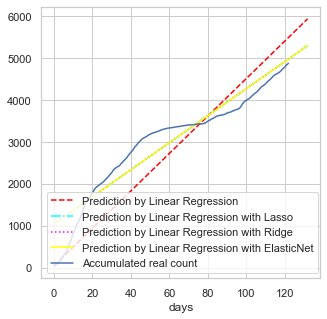

In [120]:
plt.plot(linear_pred, color='red', ls='--', label='Prediction by Linear Regression')
plt.plot(linear_pred_Lasso, color='cyan', ls='-.', label='Prediction by Linear Regression with Lasso')
plt.plot(linear_pred_Ridge, color='magenta', ls=':', label='Prediction by Linear Regression with Ridge')
plt.plot(linear_pred_ElasticNet, color='yellow', ls='solid', label='Prediction by Linear Regression with ElasticNet')
plt.plot(real_data, label='Accumulated real count')
plt.xlabel('days')
# plt.vlines(x=22, ymin=0, ymax=10000, alpha=0.3, linestyles='--')
# plt.text(x=24, y=5000, s='prediction',color='black', fontsize =20,horizontalalignment='center') 
# plt.xticks(rotation=90, ha='left')
plt.legend()
# plt.savefig('prediction by linear regression.jpg',dpi = 300)
# plt.box(False)

# Regression with None, Lasso, Ridge and ElasticNet

In [121]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet

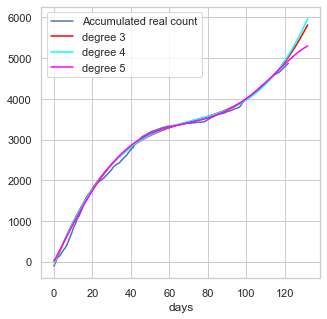

In [122]:
colors = ['red','cyan','magenta']
plt.plot(real_data, label='Accumulated real count')
plt.xlabel('days')

for color, degree in zip(colors, [3, 4, 5]):
    model = make_pipeline(PolynomialFeatures(degree), LinearRegression())
    model.fit(days, datas)
    model = model.predict(future_forecast)
    plt.plot(model,color=color,label="degree %d" % degree)
    
plt.legend(loc='best')
plt.show()

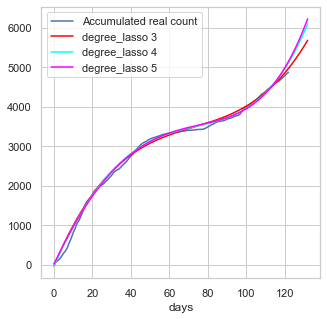

In [123]:
colors = ['red','cyan','magenta']
plt.plot(real_data, label='Accumulated real count')
plt.xlabel('days')

for color, degree in zip(colors, [3, 4, 5]):
    model = make_pipeline(PolynomialFeatures(degree), Lasso())
    model.fit(days, datas)
    model = model.predict(future_forecast)
    plt.plot(model,color=color,label="degree_lasso %d" % degree)
    
plt.legend(loc='best')
plt.show()

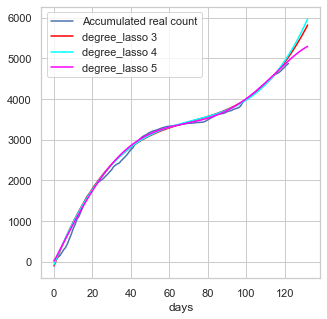

In [124]:
colors = ['red','cyan','magenta']
plt.plot(real_data, label='Accumulated real count')
plt.xlabel('days')

for color, degree in zip(colors, [3, 4, 5]):
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(days, datas)
    model = model.predict(future_forecast)
    plt.plot(model,color=color,label="degree_lasso %d" % degree)
    
plt.legend(loc='best')
plt.show()

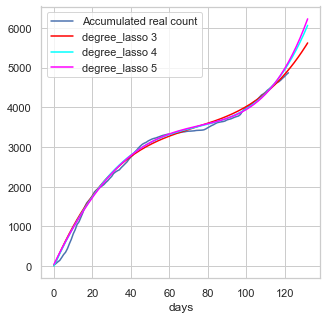

In [125]:
colors = ['red','cyan','magenta']
plt.plot(real_data, label='Accumulated real count')
plt.xlabel('days')

for color, degree in zip(colors, [3, 4, 5]):
    model = make_pipeline(PolynomialFeatures(degree), ElasticNet())
    model.fit(days, datas)
    model = model.predict(future_forecast)
    plt.plot(model,color=color,label="degree_lasso %d" % degree)
    
plt.legend(loc='best')
plt.show()

## LogisticRegressionLogisticRegression with Lasso, Ridge and Elasticnet

#### https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html

##### default :  l2

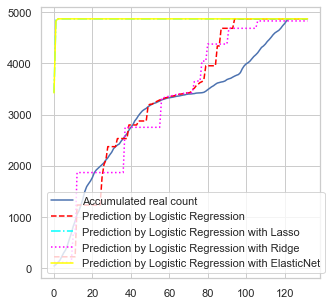

In [126]:
from sklearn.linear_model import LogisticRegression

# Answer

plt.plot(real_data, label='Accumulated real count')


#p redict

# error -> ValueError: penalty='none' is not supported for the liblinear solver
# clf = LogisticRegression(penalty = 'none')

# solver{‘newton-cg’, ‘lbfgs’, ‘liblinear’, ‘sag’, ‘saga’}, default=’lbfgs’
# Algorithm to use in the optimization problem


clf = LogisticRegression(penalty = 'none', solver = 'lbfgs')
clf.fit(days,datas)
Log_pred = clf.predict(future_forecast)

# Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.
clf_lasso = LogisticRegression(penalty = 'l1', solver = 'saga')
clf_lasso = clf_lasso.fit(days,datas)
Log_pred_lasso = clf_lasso.predict(future_forecast)


clf_Ridge = LogisticRegression(penalty = 'l2')
clf_Ridge = clf_Ridge.fit(days,datas)
Log_pred_Ridge = clf_Ridge.predict(future_forecast)


# ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.
# clf_ElasticNet = LogisticRegression(penalty = 'elasticnet')
clf_ElasticNet = LogisticRegression(penalty = 'elasticnet', solver = 'saga', l1_ratio=0.5)
clf_ElasticNet = clf_ElasticNet.fit(days,datas)
Log_pred_ElasticNet = clf_ElasticNet.predict(future_forecast)




plt.plot(Log_pred, color='red', ls='--', label='Prediction by Logistic Regression')
plt.plot(Log_pred_lasso, color='cyan', ls='-.', label='Prediction by Logistic Regression with Lasso')
plt.plot(Log_pred_Ridge, color='magenta', ls=':', label='Prediction by Logistic Regression with Ridge')
plt.plot(Log_pred_ElasticNet, color='yellow', ls='solid', label='Prediction by Logistic Regression with ElasticNet')

plt.legend(loc='best')
plt.show()

# MLPRegressor

In [127]:
from sklearn.neural_network import MLPRegressor
model = MLPRegressor(hidden_layer_sizes=[20, 10, 10, 3], max_iter=20000, random_state=42)
MLP = model.fit(days, datas)

In [128]:
MLP

MLPRegressor(hidden_layer_sizes=[20, 10, 10, 3], max_iter=20000,
             random_state=42)

In [129]:
pred_MLP = model.predict(future_forecast)

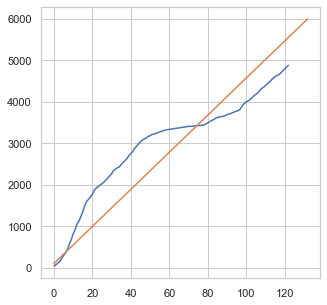

In [130]:
plt.plot(real_data, label='Accumulated real count')
plt.plot(pred_MLP, label = 'predction by Multi-layer Perceptron regressor.')

# k-NN regressor

#### https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsRegressor.html

In [131]:
#import required packages
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from math import sqrt
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor
%matplotlib inline

In [132]:
rmse_val = [] #to store rmse values for different k
for K in range(20):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K)

    model.fit(days, datas)  #fit the model
    pred_knn=model.predict(future_forecast) #make prediction on test set
    error = sqrt(mean_squared_error(data[15:],future_forecast)) #calculate rmse
    rmse_val.append(error) #store rmse values
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 3307.0898935332516
RMSE value for k=  2 is: 3307.0898935332516
RMSE value for k=  3 is: 3307.0898935332516
RMSE value for k=  4 is: 3307.0898935332516
RMSE value for k=  5 is: 3307.0898935332516
RMSE value for k=  6 is: 3307.0898935332516
RMSE value for k=  7 is: 3307.0898935332516
RMSE value for k=  8 is: 3307.0898935332516
RMSE value for k=  9 is: 3307.0898935332516
RMSE value for k=  10 is: 3307.0898935332516
RMSE value for k=  11 is: 3307.0898935332516
RMSE value for k=  12 is: 3307.0898935332516
RMSE value for k=  13 is: 3307.0898935332516
RMSE value for k=  14 is: 3307.0898935332516
RMSE value for k=  15 is: 3307.0898935332516
RMSE value for k=  16 is: 3307.0898935332516
RMSE value for k=  17 is: 3307.0898935332516
RMSE value for k=  18 is: 3307.0898935332516
RMSE value for k=  19 is: 3307.0898935332516
RMSE value for k=  20 is: 3307.0898935332516


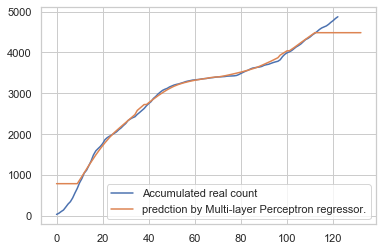

In [133]:
plt.plot(real_data, label='Accumulated real count')
plt.plot(pred_knn, label = 'predction by Multi-layer Perceptron regressor.')
plt.legend()

# K-means

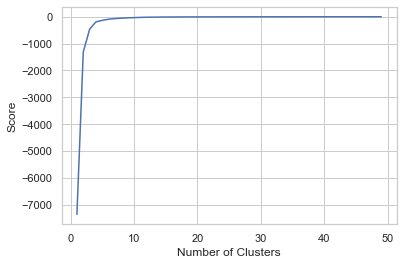

In [134]:
from sklearn.cluster import KMeans

K_clusters = range(1,50)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = route[['latitude']]
X_axis = route[['longitude']]
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.show()

In [135]:
clus=route.loc[:,['patient_id','latitude','longitude']]
kmeans = KMeans(n_clusters = 3, init ='k-means++')
kmeans.fit(clus[clus.columns[1:3]])
clus['cluster_label'] = kmeans.fit_predict(clus[clus.columns[1:3]])
centers = kmeans.cluster_centers_
labels = kmeans.predict(clus[clus.columns[1:3]])

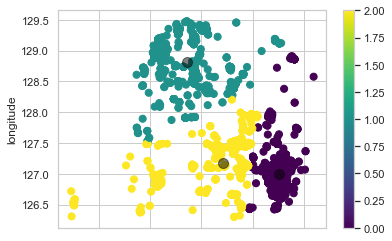

In [136]:
clus.plot.scatter(x = 'latitude', y = 'longitude', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=100, alpha=0.5)

# support vectore machine

In [137]:
# https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
# kernel = ['linear','poly','rbf']
kernel = ['linear','rbf']
c = [0.01, 0.1, 1, 10, 100]
gamma = [ 0.001, 0.01, 0.1, 10]
epsilon = [0.01, 0.1, 1, 10, 100]
shrinking = [True, False]
svm_grid = {'kernel': kernel, 'C': c, 'gamma' : gamma, 'epsilon': epsilon, 'shrinking' : shrinking}

from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR
svm = SVR()
svm_search = GridSearchCV(svm, svm_grid, scoring='neg_mean_squared_error', cv=5, return_train_score=True, n_jobs=-1,verbose=1)

# 모델 fitting 전에 train, test 를 나눠서 해봤으나, 현재 데이터셋이 너무 범위가 작아 확진자증가를 반영하지 못해. 전체 데이터셋으로 fitting 함.
svm_search.fit(days,datas)

Fitting 5 folds for each of 400 candidates, totalling 2000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:    4.9s finished


GridSearchCV(cv=5, estimator=SVR(), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1, 10, 100],
                         'epsilon': [0.01, 0.1, 1, 10, 100],
                         'gamma': [0.001, 0.01, 0.1, 10],
                         'kernel': ['linear', 'rbf'],
                         'shrinking': [True, False]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=1)

In [138]:
svm_search.best_params_

{'C': 1,
 'epsilon': 0.01,
 'gamma': 0.001,
 'kernel': 'linear',
 'shrinking': False}

In [139]:
svm_search.best_estimator_

SVR(C=1, epsilon=0.01, gamma=0.001, kernel='linear', shrinking=False)

In [140]:
svm_pred = svm_search.best_estimator_.predict(future_forecast)
svm_pred


array([1338.54681818, 1366.74      , 1394.93318182, 1423.12636364,
       1451.31954545, 1479.51272727, 1507.70590909, 1535.89909091,
       1564.09227273, 1592.28545455, 1620.47863636, 1648.67181818,
       1676.865     , 1705.05818182, 1733.25136364, 1761.44454545,
       1789.63772727, 1817.83090909, 1846.02409091, 1874.21727273,
       1902.41045455, 1930.60363636, 1958.79681818, 1986.99      ,
       2015.18318182, 2043.37636364, 2071.56954545, 2099.76272727,
       2127.95590909, 2156.14909091, 2184.34227273, 2212.53545455,
       2240.72863636, 2268.92181818, 2297.115     , 2325.30818182,
       2353.50136364, 2381.69454545, 2409.88772727, 2438.08090909,
       2466.27409091, 2494.46727273, 2522.66045455, 2550.85363636,
       2579.04681818, 2607.24      , 2635.43318182, 2663.62636364,
       2691.81954545, 2720.01272727, 2748.20590909, 2776.39909091,
       2804.59227273, 2832.78545455, 2860.97863636, 2889.17181818,
       2917.365     , 2945.55818182, 2973.75136364, 3001.94454

In [141]:
from sklearn.metrics import mean_squared_error

mean_squared_error(data[139:], svm_pred[124:])

10047.557051904247

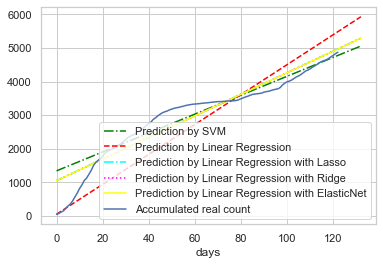

In [142]:
plt.plot(svm_pred, color='green', ls='-.', label = 'Prediction by SVM')
plt.plot(linear_pred, color='red', ls='--', label='Prediction by Linear Regression')
plt.plot(linear_pred_Lasso, color='cyan', ls='-.', label='Prediction by Linear Regression with Lasso')
plt.plot(linear_pred_Ridge, color='magenta', ls=':', label='Prediction by Linear Regression with Ridge')
plt.plot(linear_pred_ElasticNet, color='yellow', ls='solid', label='Prediction by Linear Regression with ElasticNet')
plt.plot(real_data, label='Accumulated real count')
plt.xlabel('days')
# plt.vlines(x=22, ymin=0, ymax=10000, alpha=0.3, linestyles='--')
# plt.text(x=24, y=5000, s='prediction',color='black', fontsize =20,horizontalalignment='center') 
# plt.xticks(rotation=90, ha='left')
plt.legend()
# plt.savefig('prediction by linear regression.jpg',dpi = 300)
# plt.box(False)

# Decision Tree Regressor

### https://scikit-learn.org/stable/auto_examples/tree/plot_tree_regression.html

In [143]:
from sklearn.tree import DecisionTreeRegressor
import matplotlib.pyplot as plt

In [144]:
regr_1 = DecisionTreeRegressor(max_depth=2)
regr_2 = DecisionTreeRegressor(max_depth=5)
regr_3 = DecisionTreeRegressor()
regr_1.fit(days, datas)
regr_2.fit(days, datas)
regr_3.fit(days, datas)

DecisionTreeRegressor()

In [145]:
y_1 = regr_1.predict(future_forecast)
y_2 = regr_2.predict(future_forecast)
y_3 = regr_3.predict(future_forecast)

Text(0.5, 0, 'days')

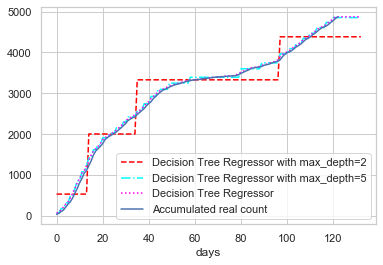

In [146]:
plt.plot(y_1, color='red', ls='--', label='Decision Tree Regressor with max_depth=2')
plt.plot(y_2, color='cyan', ls='-.', label='Decision Tree Regressor with max_depth=5')
plt.plot(y_3, color='magenta', ls=':', label='Decision Tree Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# Gradient Boosting Regressor

In [147]:
from sklearn.ensemble import GradientBoostingRegressor

In [148]:
reg = GradientBoostingRegressor(random_state=42)
reg.fit(days,datas)
reg.predict(future_forecast)

array([  67.73688313,  109.45378282,  146.36335515,  218.30959806,
        293.32175021,  350.22163967,  443.2228211 ,  565.26144881,
        677.1851238 ,  814.10329915,  917.13361201, 1046.73021775,
       1121.78602967, 1224.1840752 , 1353.74492577, 1491.89949528,
       1591.60632936, 1648.08199725, 1702.02996726, 1770.95758912,
       1866.53440425, 1917.09517373, 1947.00353734, 1992.26799223,
       2021.13506352, 2057.9266474 , 2111.11568954, 2152.49173984,
       2209.84175587, 2266.44398888, 2334.59213074, 2372.96282659,
       2404.69636664, 2427.19657463, 2476.47277271, 2532.74881377,
       2585.87483175, 2628.40294537, 2696.63653854, 2751.22715038,
       2796.80501006, 2875.01796577, 2923.32414912, 2981.62039056,
       3025.17695562, 3075.84245904, 3102.79977962, 3122.17163791,
       3143.41060277, 3191.92399368, 3202.98207174, 3212.30404912,
       3235.75470244, 3239.44127883, 3277.07749696, 3286.98529483,
       3299.97699193, 3310.83350599, 3324.2086483 , 3326.10232

Text(0.5, 0, 'days')

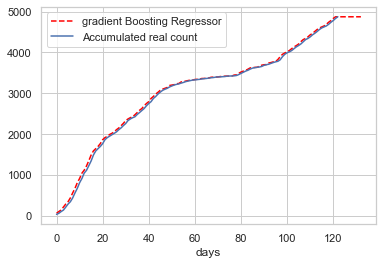

In [149]:
plt.plot(reg.predict(future_forecast), color='red', ls='--', label='gradient Boosting Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# Gaussian Naive Bayes (GaussianNB)

In [150]:
from sklearn.naive_bayes import GaussianNB

clf = GaussianNB()
clf.fit(days,datas)
clf.predict(future_forecast)

array([  67,  109,  146,  218,  293,  350,  443,  565,  677,  814,  917,
       1050, 1118, 1231, 1347, 1492, 1591, 1648, 1702, 1771, 1866, 1917,
       1952, 1987, 2021, 2058, 2111, 2155, 2212, 2262, 2335, 2373, 2404,
       2427, 2484, 2531, 2580, 2629, 2696, 2751, 2797, 2875, 2923, 2982,
       3030, 3073, 3100, 3122, 3156, 3180, 3203, 3219, 3231, 3249, 3266,
       3286, 3300, 3311, 3324, 3329, 3336, 3342, 3352, 3359, 3364, 3372,
       3381, 3386, 3396, 3402, 3403, 3407, 3411, 3420, 3423, 3425, 3428,
       3436, 3458, 3488, 3515, 3543, 3564, 3593, 3617, 3627, 3637, 3644,
       3658, 3685, 3700, 3711, 3733, 3753, 3770, 3784, 3821, 3898, 3955,
       3992, 4015, 4047, 4093, 4137, 4170, 4209, 4262, 4314, 4342, 4380,
       4430, 4468, 4512, 4561, 4599, 4624, 4648, 4688, 4738, 4780, 4832,
       4873, 4873, 4873, 4873, 4873, 4873, 4873, 4873, 4873, 4873, 4873,
       4873], dtype=int64)

Text(0.5, 0, 'days')

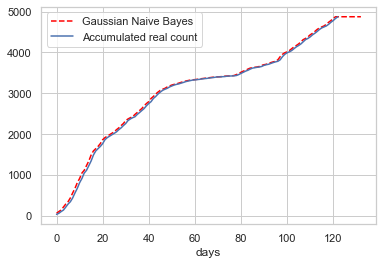

In [151]:
plt.plot(clf.predict(future_forecast), color='red', ls='--', label='Gaussian Naive Bayes')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# adaboost regressor

In [152]:
from sklearn.ensemble import AdaBoostRegressor

regr = AdaBoostRegressor(random_state=42, n_estimators=100)
regr.fit(days,datas)
regr.predict(future_forecast)

array([ 177.33333333,  177.33333333,  177.33333333,  243.9       ,
        279.41666667,  291.46666667,  424.70588235,  577.91666667,
        669.13636364,  760.375     ,  904.36      , 1007.57142857,
       1103.5       , 1172.85714286, 1331.18181818, 1496.45454545,
       1553.42857143, 1640.63636364, 1700.08333333, 1720.2       ,
       1862.14285714, 1902.4375    , 1947.        , 1957.3       ,
       2034.375     , 2071.375     , 2136.61111111, 2158.55555556,
       2184.2       , 2255.        , 2281.33333333, 2317.71428571,
       2366.64285714, 2421.72      , 2470.55      , 2561.66666667,
       2629.18181818, 2691.27272727, 2707.        , 2730.5625    ,
       2790.83333333, 2871.66666667, 2913.33333333, 3008.42857143,
       3046.63636364, 3059.23809524, 3116.95      , 3129.72727273,
       3154.57142857, 3162.11111111, 3201.        , 3218.73333333,
       3224.65384615, 3234.6       , 3264.6       , 3273.6875    ,
       3283.88372093, 3314.07142857, 3326.33333333, 3336.1    

Text(0.5, 0, 'days')

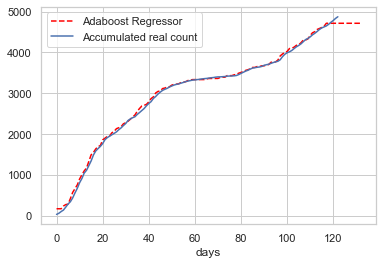

In [153]:
plt.plot(regr.predict(future_forecast), color='red', ls='--', label='Adaboost Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# SGDRegressor

### https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.SGDRegressor.html

In [154]:
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [155]:
reg = make_pipeline(StandardScaler(),SGDRegressor(max_iter=1000, tol=1e-3))
# reg = SGDRegressor()
reg.fit(days, datas)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor())])

In [156]:
reg.predict(future_forecast)

array([1046.29834995, 1078.4726735 , 1110.64699705, 1142.82132059,
       1174.99564414, 1207.16996769, 1239.34429123, 1271.51861478,
       1303.69293832, 1335.86726187, 1368.04158542, 1400.21590896,
       1432.39023251, 1464.56455606, 1496.7388796 , 1528.91320315,
       1561.0875267 , 1593.26185024, 1625.43617379, 1657.61049734,
       1689.78482088, 1721.95914443, 1754.13346798, 1786.30779152,
       1818.48211507, 1850.65643861, 1882.83076216, 1915.00508571,
       1947.17940925, 1979.3537328 , 2011.52805635, 2043.70237989,
       2075.87670344, 2108.05102699, 2140.22535053, 2172.39967408,
       2204.57399763, 2236.74832117, 2268.92264472, 2301.09696827,
       2333.27129181, 2365.44561536, 2397.61993891, 2429.79426245,
       2461.968586  , 2494.14290954, 2526.31723309, 2558.49155664,
       2590.66588018, 2622.84020373, 2655.01452728, 2687.18885082,
       2719.36317437, 2751.53749792, 2783.71182146, 2815.88614501,
       2848.06046856, 2880.2347921 , 2912.40911565, 2944.58343

Text(0.5, 0, 'days')

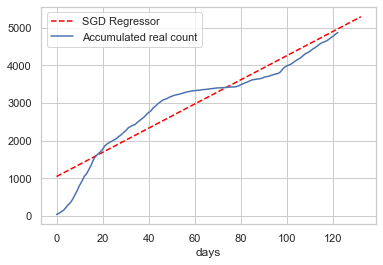

In [157]:
plt.plot(reg.predict(future_forecast), color='red', ls='--', label='SGD Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# RandomForest Regressor


### https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html

In [158]:
from sklearn.ensemble import RandomForestRegressor

regr = RandomForestRegressor()
regr.fit(days,datas)
regr.predict(future_forecast)

array([  68.22,  102.68,  139.69,  201.57,  282.77,  332.56,  427.3 ,
        541.84,  652.04,  780.84,  904.94, 1008.88, 1117.95, 1215.95,
       1322.85, 1455.3 , 1559.2 , 1634.14, 1691.16, 1758.16, 1837.31,
       1907.98, 1942.23, 1982.91, 2013.56, 2053.72, 2101.9 , 2149.2 ,
       2197.14, 2253.29, 2318.84, 2360.44, 2399.71, 2422.71, 2478.58,
       2524.48, 2568.97, 2623.43, 2687.03, 2736.31, 2792.2 , 2860.73,
       2907.47, 2970.34, 3018.1 , 3065.85, 3093.55, 3120.04, 3148.35,
       3174.5 , 3196.54, 3213.58, 3230.66, 3244.95, 3260.81, 3281.94,
       3296.8 , 3309.02, 3320.95, 3327.62, 3334.53, 3341.5 , 3349.39,
       3357.24, 3363.75, 3369.98, 3379.4 , 3385.91, 3393.11, 3400.43,
       3403.05, 3406.43, 3410.8 , 3418.17, 3422.13, 3424.39, 3428.37,
       3437.48, 3454.72, 3479.18, 3507.91, 3533.8 , 3562.36, 3588.55,
       3611.62, 3624.69, 3635.61, 3641.89, 3656.4 , 3680.62, 3694.52,
       3709.33, 3729.63, 3750.79, 3765.11, 3782.51, 3819.13, 3879.27,
       3941.7 , 3977

Text(0.5, 0, 'days')

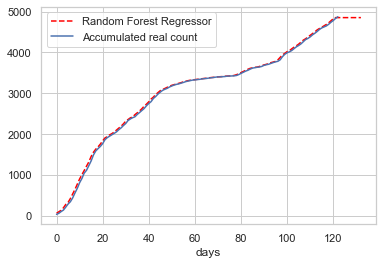

In [159]:
plt.plot(regr.predict(future_forecast), color='red', ls='--', label='Random Forest Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# XGBoost Regressor

### https://xgboost.readthedocs.io/en/latest/python/python_api.html

In [160]:
#!pip install xgboost

In [161]:
import xgboost as xgb
xgbr = xgb.XGBRegressor()
xgbr.fit(days,datas)
xgbr.predict(future_forecast)

[18:42:57] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


array([  68.55115,  110.27728,  147.27037,  219.01971,  292.075  ,
        352.68225,  443.6972 ,  565.07635,  678.4381 ,  801.5234 ,
        930.2568 , 1050.5853 , 1117.1036 , 1233.036  , 1340.4933 ,
       1499.5243 , 1590.8497 , 1649.003  , 1697.5681 , 1776.314  ,
       1866.0931 , 1917.2847 , 1952.3878 , 1987.666  , 2016.0146 ,
       2057.2905 , 2108.7717 , 2155.3596 , 2220.4336 , 2242.0125 ,
       2355.0144 , 2373.5916 , 2397.2517 , 2397.2517 , 2522.1414 ,
       2529.8103 , 2580.9517 , 2592.5525 , 2696.234  , 2787.293  ,
       2796.53   , 2874.7192 , 2924.4045 , 2981.8809 , 3030.9602 ,
       3069.2515 , 3098.9973 , 3125.7368 , 3149.8108 , 3149.8108 ,
       3229.5715 , 3229.5715 , 3231.049  , 3244.503  , 3266.0078 ,
       3284.821  , 3301.2373 , 3315.3796 , 3323.9712 , 3328.6355 ,
       3328.6355 , 3328.6355 , 3364.5798 , 3364.5798 , 3364.5798 ,
       3370.1138 , 3382.8176 , 3385.4463 , 3394.9055 , 3403.423  ,
       3403.423  , 3404.6006 , 3412.3772 , 3419.057  , 3419.55

In [162]:
score = xgbr.score(days, datas)  
print("Training score: ", score)

Training score:  0.9999151153853785


Text(0.5, 0, 'days')

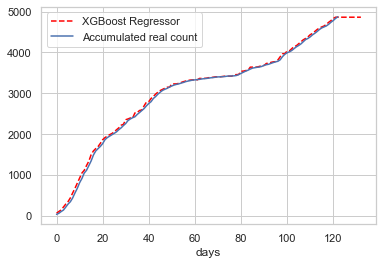

In [163]:
plt.plot(xgbr.predict(future_forecast), color='red', ls='--', label='XGBoost Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# lightgbm Regressor

### https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMRegressor.html

In [164]:
#!pip install lightgbm

In [165]:
import lightgbm as lgb

gbm = lgb.LGBMRegressor()
gbm.fit(days,datas)
gbm.predict(future_forecast)


array([ 882.70492125,  882.70492125,  882.70492125,  882.70492125,
        882.70492125,  882.70492125,  882.70492125,  882.70492125,
        882.70492125,  882.70492125,  882.70492125,  882.70492125,
        882.70492125,  882.70492125,  882.70492125,  882.70492125,
        882.70492125,  882.70492125,  882.70492125,  882.70492125,
        882.70492125, 1957.48933815, 1957.48933815, 1957.48933815,
       2067.06671227, 2067.06671227, 2067.06671227, 2222.0876559 ,
       2222.0876559 , 2222.0876559 , 2378.00653537, 2378.00653537,
       2378.00653537, 2484.86253746, 2484.86253746, 2484.86253746,
       2645.561769  , 2645.561769  , 2645.561769  , 2739.59253616,
       2739.59253616, 2739.59253616, 2988.56786324, 2988.56786324,
       2988.56786324, 3110.13738898, 3110.13738898, 3110.13738898,
       3187.51108149, 3187.51108149, 3187.51108149, 3240.55110073,
       3240.55110073, 3240.55110073, 3282.97775988, 3282.97775988,
       3282.97775988, 3329.85871248, 3329.85871248, 3329.85871

Text(0.5, 0, 'days')

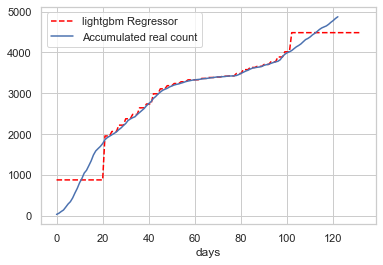

In [166]:
plt.plot(gbm.predict(future_forecast), color='red', ls='--', label='lightgbm Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# Catboost

In [167]:
#!pip install catbosst

In [168]:
from catboost import CatBoostRegressor

catboost_model = CatBoostRegressor(loss_function='RMSE', depth=3, learning_rate=0.4, iterations=1000, 
    random_seed=18, 
    od_type='Iter',
    od_wait=20,
)

In [169]:
catboost_model.fit(days, datas)

0:	learn: 864.8396073	total: 54.3ms	remaining: 54.3s
1:	learn: 640.0960541	total: 54.6ms	remaining: 27.2s
2:	learn: 456.8123325	total: 54.8ms	remaining: 18.2s
3:	learn: 325.4036359	total: 55ms	remaining: 13.7s
4:	learn: 250.0704927	total: 55.2ms	remaining: 11s
5:	learn: 195.6950787	total: 55.4ms	remaining: 9.18s
6:	learn: 159.9480144	total: 55.6ms	remaining: 7.89s
7:	learn: 136.7815860	total: 55.9ms	remaining: 6.93s
8:	learn: 116.6220723	total: 56.1ms	remaining: 6.17s
9:	learn: 105.8376115	total: 56.4ms	remaining: 5.59s
10:	learn: 98.5631066	total: 56.7ms	remaining: 5.09s
11:	learn: 95.5662168	total: 56.9ms	remaining: 4.68s
12:	learn: 91.0860107	total: 57.1ms	remaining: 4.34s
13:	learn: 84.9722815	total: 57.3ms	remaining: 4.04s
14:	learn: 83.2694675	total: 57.5ms	remaining: 3.78s
15:	learn: 79.7545649	total: 57.7ms	remaining: 3.55s
16:	learn: 77.6354064	total: 58ms	remaining: 3.35s
17:	learn: 76.4616510	total: 58.2ms	remaining: 3.17s
18:	learn: 75.6407618	total: 58.4ms	remaining: 3.01s

508:	learn: 3.5271347	total: 165ms	remaining: 159ms
509:	learn: 3.5014731	total: 165ms	remaining: 159ms
510:	learn: 3.4851970	total: 165ms	remaining: 158ms
511:	learn: 3.4761110	total: 166ms	remaining: 158ms
512:	learn: 3.4567493	total: 166ms	remaining: 157ms
513:	learn: 3.4343664	total: 166ms	remaining: 157ms
514:	learn: 3.4321327	total: 166ms	remaining: 157ms
515:	learn: 3.4111402	total: 166ms	remaining: 156ms
516:	learn: 3.4031171	total: 167ms	remaining: 156ms
517:	learn: 3.3844725	total: 167ms	remaining: 155ms
518:	learn: 3.3774913	total: 167ms	remaining: 155ms
519:	learn: 3.3751046	total: 167ms	remaining: 155ms
520:	learn: 3.3737394	total: 168ms	remaining: 154ms
521:	learn: 3.3616662	total: 168ms	remaining: 154ms
522:	learn: 3.3521458	total: 168ms	remaining: 153ms
523:	learn: 3.3370243	total: 168ms	remaining: 153ms
524:	learn: 3.3138350	total: 169ms	remaining: 152ms
525:	learn: 3.3006681	total: 169ms	remaining: 152ms
526:	learn: 3.2982814	total: 169ms	remaining: 152ms
527:	learn: 

In [170]:
catboost_model.predict(future_forecast)

array([  66.89495394,  109.16849107,  145.68749809,  218.21790305,
        292.81878305,  350.25726901,  442.90884164,  564.81082132,
        677.32951266,  813.60655489,  916.8899326 , 1050.40924305,
       1117.93203769, 1231.15345161, 1346.38680222, 1492.58564457,
       1591.14325458, 1647.40255335, 1702.73974836, 1770.83847582,
       1866.28920067, 1916.1306106 , 1952.90950729, 1985.9704888 ,
       2020.84321251, 2058.76190931, 2111.3526329 , 2153.74228296,
       2213.07966879, 2262.31213779, 2333.71649368, 2372.69175446,
       2404.3973609 , 2428.38737121, 2482.2228834 , 2532.2119555 ,
       2580.60214218, 2627.1896905 , 2697.83461604, 2748.95297221,
       2798.72994889, 2875.54241469, 2921.11136917, 2981.92896125,
       3029.6255945 , 3074.60021541, 3098.55415146, 3123.35767439,
       3156.52580306, 3178.01355485, 3205.16187709, 3217.04761774,
       3230.76144227, 3250.71771475, 3264.424275  , 3287.80650451,
       3298.21558789, 3312.80615673, 3323.95111955, 3327.76507

Text(0.5, 0, 'days')

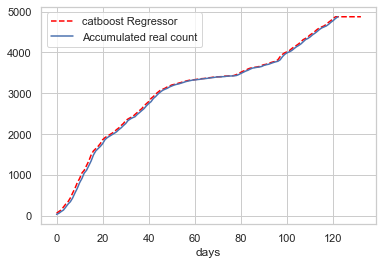

In [171]:
plt.plot(catboost_model.predict(future_forecast), color='red', ls='--', label='catboost Regressor')
plt.plot(real_data, label='Accumulated real count')
plt.legend()
plt.xlabel('days')

# 3. Deep learning

# RNN 

### https://3months.tistory.com/168

In [172]:
dataset

,patient_id
confirmed_date,
2020-02-18,39
2020-02-19,67
2020-02-20,109
2020-02-21,146
2020-02-22,218
2020-02-23,293
2020-02-24,350
2020-02-25,443
2020-02-26,565


In [173]:
dataset.columns = ['Confirmed']
len(dataset)

123

In [174]:
data = np.array(dataset).reshape(-1, 1) # count->ndarray

In [175]:
train_data = dataset[:len(dataset)-10]
test_data = dataset[len(dataset)-10:]

In [176]:
train_data = pd.DataFrame(train_data)
test_data = pd.DataFrame(test_data)

In [177]:
print(train_data.shape)
print(test_data.shape)

(113, 1)
(10, 1)


In [178]:
# Before creating LSTM model we should create a Time Series Generator object.

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(train_data)
scaled_train_data = scaler.transform(train_data)
scaled_test_data = scaler.transform(test_data)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, SimpleRNN
from tensorflow.keras.callbacks import EarlyStopping


from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
n_input = 10
n_features =1
                             
generator = TimeseriesGenerator(scaled_train_data,scaled_train_data, length=n_input, batch_size=1)

rnn_model = Sequential()
rnn_model.add(SimpleRNN(30, activation='relu', input_shape = (n_input, n_features)))
rnn_model.add(Dense(10))
rnn_model.add(Dense(5))
rnn_model.add(Dense(1))
rnn_model.compile(optimizer='adam', loss='mse',metrics=['accuracy'])
rnn_model.summary()

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn (SimpleRNN)       (None, 30)                960       
_________________________________________________________________
dense (Dense)                (None, 10)                310       
_________________________________________________________________
dense_1 (Dense)              (None, 5)                 55        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 6         
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________


In [179]:
early_stopping_callback = EarlyStopping(monitor = 'loss', mode='min', verbose=1, patience=50)
history = rnn_model.fit_generator(generator, epochs=20, callbacks=[early_stopping_callback])

Epoch 1/20
103/103 [==============================] - 1s 13ms/step - loss: 0.0105 - acc: 0.0097
Epoch 2/20
103/103 [==============================] - 1s 7ms/step - loss: 4.9634e-04 - acc: 0.0097
Epoch 3/20
103/103 [==============================] - 1s 7ms/step - loss: 3.6203e-04 - acc: 0.0097
Epoch 4/20
103/103 [==============================] - 1s 8ms/step - loss: 5.4586e-04 - acc: 0.0097
Epoch 5/20
103/103 [==============================] - 1s 7ms/step - loss: 3.1611e-04 - acc: 0.0097
Epoch 6/20
103/103 [==============================] - 1s 7ms/step - loss: 3.8921e-04 - acc: 0.0097
Epoch 7/20
103/103 [==============================] - 1s 7ms/step - loss: 2.6779e-04 - acc: 0.0097
Epoch 8/20
103/103 [==============================] - 1s 7ms/step - loss: 3.5841e-04 - acc: 0.0097
Epoch 9/20
103/103 [==============================] - 1s 7ms/step - loss: 2.6015e-04 - acc: 0.0097
Epoch 10/20
103/103 [==============================] - 1s 7ms/step - loss: 2.8626e-04 - acc: 0.0097
Epoch 11/20


In [180]:
rnn_model.history.history.keys()

dict_keys(['loss', 'acc'])

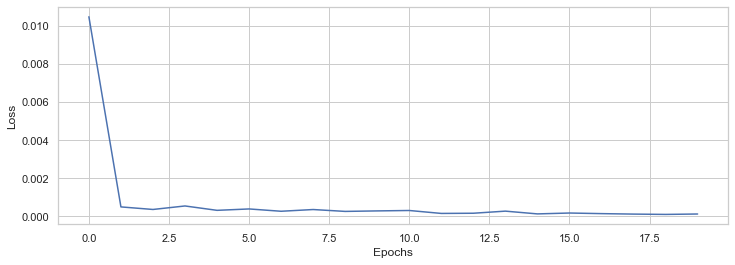

In [181]:
losses_rnn = rnn_model.history.history['loss']
plt.figure(figsize = (12,4))
plt.xlabel('Epochs')
plt.ylabel('Loss')
# plt.xticks(np.arange(0,21,1))
plt.plot(range(len(losses_rnn)), losses_rnn)

In [182]:
rnn_predictions_scaled = []

batch = scaled_train_data[-n_input:]
current_batch = batch.reshape((1, n_input, n_features))

for i in range(len(test_data)):   
    rnn_pred = rnn_model.predict(current_batch)[0]
    rnn_predictions_scaled.append(rnn_pred) 
    current_batch = np.append(current_batch[:,1:,:],[[rnn_pred]],axis=1)


# As you know we scaled our data that’s why we have to inverse it to see true predictions.
rnn_predictions_scaled

[array([1.0248548], dtype=float32),
 array([1.0384406], dtype=float32),
 array([1.0535338], dtype=float32),
 array([1.0726479], dtype=float32),
 array([1.0891358], dtype=float32),
 array([1.107048], dtype=float32),
 array([1.1262949], dtype=float32),
 array([1.1453099], dtype=float32),
 array([1.1642338], dtype=float32),
 array([1.1837164], dtype=float32)]

### Reference : https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html

In [183]:
# inverser_transform : Scale back the data to the original representation
rnn_predictions = scaler.inverse_transform(rnn_predictions_scaled) # 열로 넣어줘야 시각화 할수 있음
rnn_predictions

array([[4578.08181727],
       [4638.25335157],
       [4705.10116696],
       [4789.75767839],
       [4862.78230774],
       [4942.11574554],
       [5027.35989642],
       [5111.57765818],
       [5195.3915168 ],
       [5281.68000805]])

In [184]:
# Before creating LSTM model we should create a Time Series Generator object.

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(train_data)
scaled_train_data = scaler.transform(train_data)
scaled_test_data = scaler.transform(test_data)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.callbacks import EarlyStopping


from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
n_input = 10
n_features =1
                             
generator = TimeseriesGenerator(scaled_train_data,scaled_train_data, length=n_input, batch_size=1)

lstm_model = Sequential()
lstm_model.add(LSTM(30, activation='relu', input_shape = (n_input, n_features)))
lstm_model.add(Dense(10))
lstm_model.add(Dense(5))
lstm_model.add(Dense(1))
lstm_model.compile(optimizer='adam', loss='mse',metrics=['accuracy'])
lstm_model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 30)                3840      
_________________________________________________________________
dense_3 (Dense)              (None, 10)                310       
_________________________________________________________________
dense_4 (Dense)              (None, 5)                 55        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 6         
Total params: 4,211
Trainable params: 4,211
Non-trainable params: 0
_________________________________________________________________


# Early stoppoing Callback

##https://3months.tistory.com/424


### 만약 performance measure 를 practical 하게 설정한 경우 성능의 증가의 기준을 직접 정의할 수 있다. 예를 들어 아래 코드는 validation accuracy 가 1% 증가하지 않는 경우, 성능의 증가가 없다고 정의한다.  특정값에 도달했을 때, 더 이상 training 이 필요하지 않은 경우가 있다. 이 경우 baseline 파라미터를 통해 정의할 수 있다.



In [185]:
early_stopping_callback = EarlyStopping(monitor = 'loss', mode='min', verbose=1, patience=50)
history = lstm_model.fit_generator(generator, epochs=20, callbacks=[early_stopping_callback])

Epoch 1/20
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
103/103 [==============================] - 2s 24ms/step - loss: 0.1158 - acc: 0.0000e+00
Epoch 2/20
103/103 [==============================] - 2s 15ms/step - loss: 9.9207e-04 - acc: 0.0097
Epoch 3/20
103/103 [==============================] - 2s 15ms/step - loss: 2.1176e-04 - acc: 0.0097
Epoch 4/20
103/103 [==============================] - 2s 15ms/step - loss: 1.8859e-04 - acc: 0.0097
Epoch 5/20
103/103 [==============================] - 2s 15ms/step - loss: 1.8205e-04 - acc: 0.0097
Epoch 6/20
103/103 [==============================] - 2s 15ms/step - loss: 1.9101e-04 - acc: 0.0097
Epoch 7/20
103/103 [==============================] - 2s 15ms/step - loss: 2.1277e-04 - acc: 0.0097
Epoch 8/20
103/103 [==============================] - 1s 14ms/step - loss: 2.2609e-04 - acc: 0.0097
Epoch 9/20
103/103 [==============================] - 2s 15ms/step - loss: 2.3348e-04 - acc: 0.0097
Epoch 

In [186]:
lstm_model.history.history.keys()

dict_keys(['loss', 'acc'])

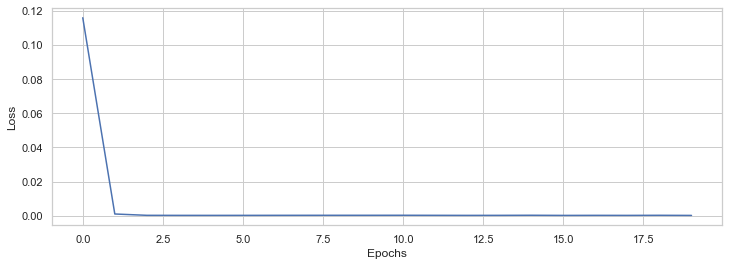

In [187]:
losses_lstm = lstm_model.history.history['loss']
plt.figure(figsize = (12,4))
plt.xlabel('Epochs')
plt.ylabel('Loss')
# plt.xticks(np.arange(0,21,1))
plt.plot(range(len(losses_lstm)), losses_lstm)

In [188]:
lstm_predictions_scaled = []

batch = scaled_train_data[-n_input:]
current_batch = batch.reshape((1, n_input, n_features))

for i in range(len(test_data)):   
    lstm_pred = lstm_model.predict(current_batch)[0]
    lstm_predictions_scaled.append(lstm_pred) 
    current_batch = np.append(current_batch[:,1:,:],[[lstm_pred]],axis=1)


# As you know we scaled our data that’s why we have to inverse it to see true predictions.
lstm_predictions_scaled

[array([0.99015677], dtype=float32),
 array([0.99698776], dtype=float32),
 array([1.0037243], dtype=float32),
 array([1.0104179], dtype=float32),
 array([1.017166], dtype=float32),
 array([1.0239925], dtype=float32),
 array([1.0310977], dtype=float32),
 array([1.0383999], dtype=float32),
 array([1.04585], dtype=float32),
 array([1.0533853], dtype=float32)]

In [189]:
lstm_predictions = scaler.inverse_transform(lstm_predictions_scaled) # 열로 넣어줘야 시각화 할수 있음
lstm_predictions

array([[4424.40433323],
       [4454.65878934],
       [4484.49508691],
       [4514.14104843],
       [4544.02829587],
       [4574.2629528 ],
       [4605.73149419],
       [4638.07331109],
       [4671.06982064],
       [4704.44330645]])

In [190]:
# test_data['ARIMA'] = pred_Arima
test_data['MLP regression'] = pred_MLP[123:]
test_data['RNN_predictions'] = rnn_predictions
test_data['LSTM_Predictions'] = lstm_predictions

test_data

,Confirmed,MLP regression,RNN_predictions,LSTM_Predictions
confirmed_date,,,,
2020-06-11,4512,5590.856013,4578.081817,4424.404333
2020-06-12,4561,5635.501439,4638.253352,4454.658789
2020-06-13,4599,5680.146865,4705.101167,4484.495087
2020-06-14,4624,5724.792292,4789.757678,4514.141048
2020-06-15,4648,5769.437718,4862.782308,4544.028296
2020-06-16,4688,5814.083144,4942.115746,4574.262953
2020-06-17,4738,5858.728570,5027.359896,4605.731494
2020-06-18,4780,5903.373997,5111.577658,4638.073311
2020-06-19,4832,5948.019423,5195.391517,4671.069821


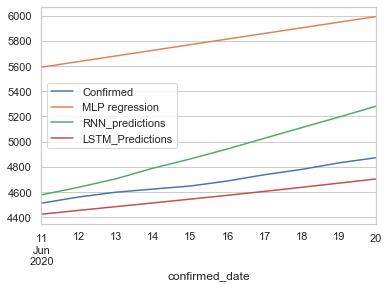

In [191]:
test_data.plot()

In [192]:
# Before creating LSTM model we should create a Time Series Generator object.

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(train_data)
scaled_train_data = scaler.transform(train_data)
scaled_test_data = scaler.transform(test_data)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM,GRU
from tensorflow.keras.callbacks import EarlyStopping


from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
n_input = 10
n_features =1
                             
generator = TimeseriesGenerator(scaled_train_data,scaled_train_data, length=n_input, batch_size=1)

gru_model = Sequential()
gru_model.add(GRU(30, activation='relu', input_shape = (n_input, n_features)))
gru_model.add(Dense(10))
gru_model.add(Dense(5))
gru_model.add(Dense(1))
gru_model.compile(optimizer='adam', loss='mse',metrics=['accuracy'])
gru_model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
gru (GRU)                    (None, 30)                2880      
_________________________________________________________________
dense_6 (Dense)              (None, 10)                310       
_________________________________________________________________
dense_7 (Dense)              (None, 5)                 55        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 6         
Total params: 3,251
Trainable params: 3,251
Non-trainable params: 0
_________________________________________________________________


In [193]:
early_stopping_callback = EarlyStopping(monitor = 'loss', mode='min', verbose=1, patience=50)
history = gru_model.fit_generator(generator, epochs=20, callbacks=[early_stopping_callback])

Epoch 1/20
103/103 [==============================] - 2s 22ms/step - loss: 0.0988 - acc: 0.0000e+00
Epoch 2/20
103/103 [==============================] - 1s 14ms/step - loss: 0.0029 - acc: 0.0097
Epoch 3/20
103/103 [==============================] - 1s 13ms/step - loss: 1.9738e-04 - acc: 0.0097
Epoch 4/20
103/103 [==============================] - 1s 13ms/step - loss: 1.4446e-04 - acc: 0.0097
Epoch 5/20
103/103 [==============================] - 1s 13ms/step - loss: 1.4704e-04 - acc: 0.0097
Epoch 6/20
103/103 [==============================] - 1s 14ms/step - loss: 1.4745e-04 - acc: 0.0097
Epoch 7/20
103/103 [==============================] - 1s 13ms/step - loss: 1.7756e-04 - acc: 0.0097
Epoch 8/20
103/103 [==============================] - 2s 15ms/step - loss: 1.2315e-04 - acc: 0.0097
Epoch 9/20
103/103 [==============================] - 2s 16ms/step - loss: 1.1290e-04 - acc: 0.0097
Epoch 10/20
103/103 [==============================] - 1s 13ms/step - loss: 1.6785e-04 - acc: 0.0097
Epo

In [194]:
gru_model.history.history.keys()

dict_keys(['loss', 'acc'])

No handles with labels found to put in legend.


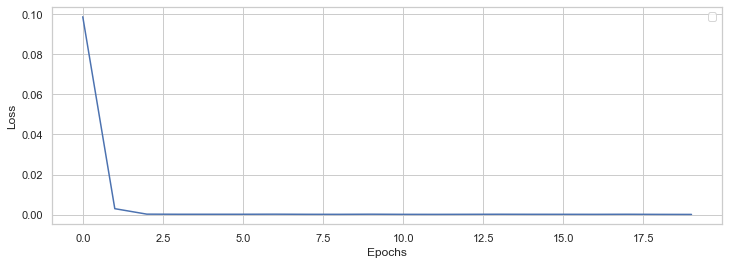

In [195]:
losses_gru = gru_model.history.history['loss']
plt.figure(figsize = (12,4))
plt.xlabel('Epochs')
plt.ylabel('Loss')
# plt.xticks(np.arange(0,21,1))
plt.plot(range(len(losses_gru)), losses_gru)
plt.legend()

In [196]:
gru_predictions_scaled = []

batch = scaled_train_data[-n_input:]
current_batch = batch.reshape((1, n_input, n_features))

for i in range(len(test_data)):   
    gru_pred = lstm_model.predict(current_batch)[0]
    gru_predictions_scaled.append(gru_pred) 
    current_batch = np.append(current_batch[:,1:,:],[[lstm_pred]],axis=1)


# As you know we scaled our data that’s why we have to inverse it to see true predictions.
gru_predictions_scaled

[array([0.99015677], dtype=float32),
 array([1.0099804], dtype=float32),
 array([1.0273261], dtype=float32),
 array([1.0421882], dtype=float32),
 array([1.0541921], dtype=float32),
 array([1.0638947], dtype=float32),
 array([1.0715814], dtype=float32),
 array([1.0779765], dtype=float32),
 array([1.0831335], dtype=float32),
 array([1.0870087], dtype=float32)]

In [197]:
gru_predictions = scaler.inverse_transform(gru_predictions_scaled) # 열로 넣어줘야 시각화 할수 있음
gru_predictions

array([[4424.40433323],
       [4512.20336938],
       [4589.02732801],
       [4654.85139418],
       [4708.01666117],
       [4750.98984194],
       [4785.03385973],
       [4813.35776448],
       [4836.19809031],
       [4853.3615973 ]])

In [198]:
test_data['MLP regression'] = pred_MLP[123:]
test_data['RNN_predictions'] = rnn_predictions
test_data['LSTM_Predictions'] = lstm_predictions
test_data['GRU_predictions'] = gru_predictions

test_data

,Confirmed,MLP regression,RNN_predictions,LSTM_Predictions,GRU_predictions
confirmed_date,,,,,
2020-06-11,4512,5590.856013,4578.081817,4424.404333,4424.404333
2020-06-12,4561,5635.501439,4638.253352,4454.658789,4512.203369
2020-06-13,4599,5680.146865,4705.101167,4484.495087,4589.027328
2020-06-14,4624,5724.792292,4789.757678,4514.141048,4654.851394
2020-06-15,4648,5769.437718,4862.782308,4544.028296,4708.016661
2020-06-16,4688,5814.083144,4942.115746,4574.262953,4750.989842
2020-06-17,4738,5858.728570,5027.359896,4605.731494,4785.033860
2020-06-18,4780,5903.373997,5111.577658,4638.073311,4813.357764
2020-06-19,4832,5948.019423,5195.391517,4671.069821,4836.198090


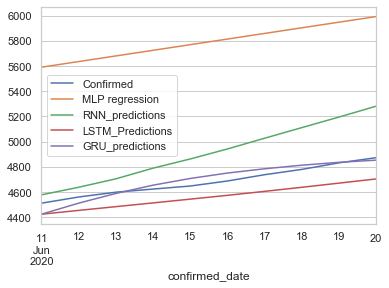

In [199]:
test_data.plot()

Time series Generator is a Utility class for generating batches of temporal data in keras i.e. producing batches for training/validation from a regular time series data. These batches will be fed to train the model.

In [200]:
# Before creating LSTM model we should create a Time Series Generator object.

from sklearn.preprocessing import MinMaxScaler
import numpy as np
scaler = MinMaxScaler()
scaler.fit(train_data)
scaled_train_data = scaler.transform(train_data)
scaled_test_data = scaler.transform(test_data)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,RNN,LSTM,GRU, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping


from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
n_input = 10
n_features =1
                             
generator = TimeseriesGenerator(scaled_train_data,scaled_train_data, length=n_input, batch_size=1)

# model = Sequential()
# model.add(Bidirectional(LSTM(10, return_sequences=True), input_shape=(n_input, n_features)))
# model.add(Bidirectional(LSTM(10)))
# model.add(Dense(5))
# model.add(Dense(1))
# model.compile(optimizer='adam', loss='mse')
# model.summary()

bidictional_model = Sequential()
bidictional_model.add(Bidirectional(LSTM(30, activation='relu',return_sequences=True), input_shape = (n_input, n_features)))
bidictional_model.add(Bidirectional(LSTM(30)))
bidictional_model.add(Dense(10))
bidictional_model.add(Dense(5))
bidictional_model.add(Dense(1))
bidictional_model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])
bidictional_model.summary()


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional (Bidirectional (None, 10, 60)            7680      
_________________________________________________________________
bidirectional_1 (Bidirection (None, 60)                21840     
_________________________________________________________________
dense_9 (Dense)              (None, 10)                610       
_________________________________________________________________
dense_10 (Dense)             (None, 5)                 55        
______________________________

In [201]:
early_stopping_callback = EarlyStopping(monitor = 'loss', mode='min', verbose=1, patience=50)
history = bidictional_model.fit_generator(generator, epochs=20, callbacks=[early_stopping_callback])

Epoch 1/20
103/103 [==============================] - 7s 72ms/step - loss: 0.0201 - acc: 0.0097
Epoch 2/20
103/103 [==============================] - 4s 42ms/step - loss: 6.1083e-04 - acc: 0.0097
Epoch 3/20
103/103 [==============================] - 4s 42ms/step - loss: 4.5688e-04 - acc: 0.0097
Epoch 4/20
103/103 [==============================] - 5s 45ms/step - loss: 5.4145e-04 - acc: 0.0097
Epoch 5/20
103/103 [==============================] - 4s 42ms/step - loss: 7.3407e-04 - acc: 0.0097
Epoch 6/20
103/103 [==============================] - 4s 43ms/step - loss: 4.4223e-04 - acc: 0.0097
Epoch 7/20
103/103 [==============================] - 4s 42ms/step - loss: 8.6083e-04 - acc: 0.0097
Epoch 8/20
103/103 [==============================] - 4s 42ms/step - loss: 4.1684e-04 - acc: 0.0097
Epoch 9/20
103/103 [==============================] - 4s 42ms/step - loss: 5.6918e-04 - acc: 0.0097
Epoch 10/20
103/103 [==============================] - 4s 42ms/step - loss: 3.4538e-04 - acc: 0.0097
Epo

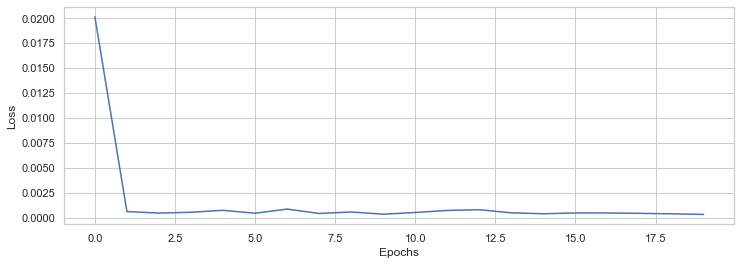

In [202]:
losses_bidictional = bidictional_model.history.history['loss']
plt.figure(figsize = (12,4))
plt.xlabel('Epochs')
plt.ylabel('Loss')
# plt.xticks(np.arange(0,21,1))
plt.plot(range(len(losses_bidictional)), losses_bidictional)

In [203]:
bidictional_predictions_scaled = []

batch = scaled_train_data[-n_input:]
current_batch = batch.reshape((1, n_input, n_features))

for i in range(len(test_data)):   
    bidictional_pred = bidictional_model.predict(current_batch)[0]
    bidictional_predictions_scaled.append(bidictional_pred) 
    current_batch = np.append(current_batch[:,1:,:],[[lstm_pred]],axis=1)


# As you know we scaled our data that’s why we have to inverse it to see true predictions.
bidictional_predictions_scaled

[array([0.9903398], dtype=float32),
 array([1.0075202], dtype=float32),
 array([1.0231594], dtype=float32),
 array([1.0371847], dtype=float32),
 array([1.049458], dtype=float32),
 array([1.0599296], dtype=float32),
 array([1.0687884], dtype=float32),
 array([1.0762734], dtype=float32),
 array([1.0822634], dtype=float32),
 array([1.08665], dtype=float32)]

In [204]:
bidictional_predictions = scaler.inverse_transform(bidictional_predictions_scaled) # 열로 넣어줘야 시각화 할수 있음
bidictional_predictions

array([[4425.21504337],
       [4501.30696058],
       [4570.57291496],
       [4632.69110394],
       [4687.04960108],
       [4733.42823958],
       [4772.66386449],
       [4805.81507158],
       [4832.34437931],
       [4851.77291167]])

In [205]:
test_data['MLP regression'] = pred_MLP[123:]
test_data['RNN_predictions'] = rnn_predictions
test_data['LSTM_Predictions'] = lstm_predictions
test_data['GRU_predictions'] = gru_predictions
test_data['bidictional_predictions'] = bidictional_predictions_scaled

test_data

,Confirmed,MLP regression,RNN_predictions,LSTM_Predictions,GRU_predictions,bidictional_predictions
confirmed_date,,,,,,
2020-06-11,4512,5590.856013,4578.081817,4424.404333,4424.404333,[0.9903398]
2020-06-12,4561,5635.501439,4638.253352,4454.658789,4512.203369,[1.0075202]
2020-06-13,4599,5680.146865,4705.101167,4484.495087,4589.027328,[1.0231594]
2020-06-14,4624,5724.792292,4789.757678,4514.141048,4654.851394,[1.0371847]
2020-06-15,4648,5769.437718,4862.782308,4544.028296,4708.016661,[1.049458]
2020-06-16,4688,5814.083144,4942.115746,4574.262953,4750.989842,[1.0599296]
2020-06-17,4738,5858.728570,5027.359896,4605.731494,4785.033860,[1.0687884]
2020-06-18,4780,5903.373997,5111.577658,4638.073311,4813.357764,[1.0762734]
2020-06-19,4832,5948.019423,5195.391517,4671.069821,4836.198090,[1.0822634]


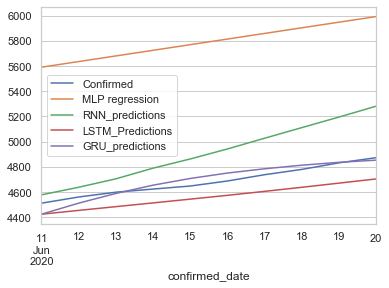

In [206]:
test_data.plot()

# Time Seies Analysis study

### Reference : https://otexts.com/fpp2/

 - 시계열자료(time series data)에서는 현재의 상태가 과거와 미래의 상태에 밀접한 연관을 지니는 경우가 많다. 이럴 때 자기상관(autocorrelation) 또는 계열상관(series correlation)이 있다고 한다.

## Reference : https://www.kaggle.com/ginajiyoungsong/prediction-by-prophet-mlp-lstm-etc-eda-analysis#LSTM-with-Time-Series-Generator

 - Prophet model 로 예측한 값을 가장 마지막에 ARIMA 와 비교해보려고 합니다. # ARIMA model

시계열 자료 - 시간의 흐름에 따라 관찰된 데이터
시계열 모형

 (1) 자기회귀 모형 (Autoregressive model, AR)
(2) 이동평균 모형 (Moving average model, MA)
(3) AR + MA = ARMA
ARIMA, 자기회귀누적이동평균 모형 (Autoregressive integrated moving average model)

비정상 시계열 모형 차분이나 변환을 통해 AR, MA, 또는 이 둘을 합한 ARMA 모형으로 정상화
ARIMA(p, d, q) - d : 차분 차수 / p : AR 모형 차수 / q : MA 모형 차수
모형 그 자체에 이러한 비정상성을 제거하는 과정을 포함한것이 ARIMA모형이며 ARIMA(p, d, q)로 표현한다.

  I: Integrated. 누적을 의미하는 것으로, 차분을 이용하는 시계열모형들에 붙이는 표현이라고 생각하면 편하다. 
  차분(Diffrence)횟수를 의미하는 d

 - acf

Plot the autocorrelation function

Plots lags on the horizontal and the correlations on vertical axis.

In [207]:
train_data = pd.DataFrame(train_data)

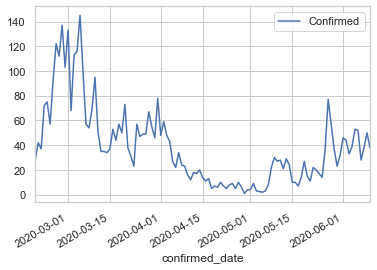

In [208]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
#시계열 자료 {  Yt } 의 상관 함수는 acf, pacf, iacf 가 있는데 이는 ARMA 모형 진단에 사용된다.
diff_1=train_data.diff(periods=1).iloc[1:] # diff() 차분함수 => 1차 차분함수
diff_1.plot()

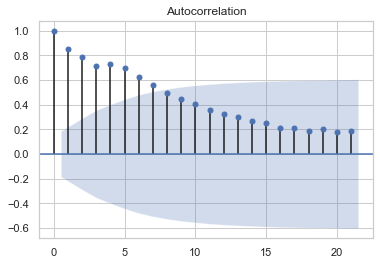

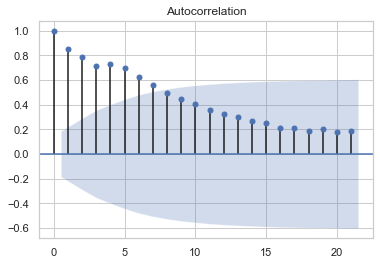

In [209]:
plot_acf(diff_1)

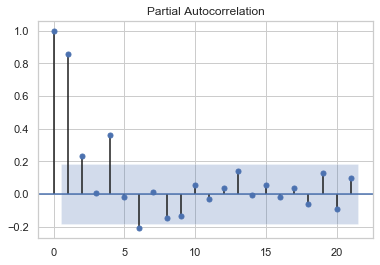

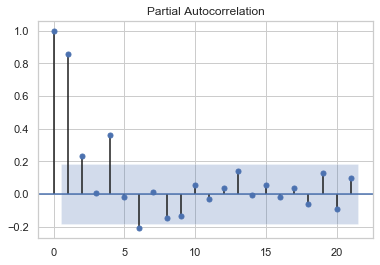

In [210]:
plot_pacf(diff_1)

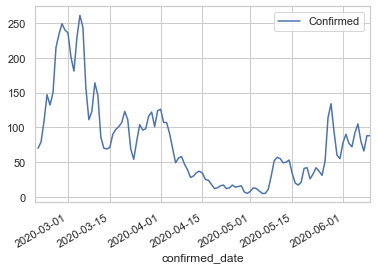

In [211]:
diff_1=train_data.diff(periods=2).iloc[1:] # diff() 차분함수 => 2차 차분함수
diff_1.plot()

# Prophet

# data

In [212]:
daily_count = patient.groupby('confirmed_date').patient_id.count()
daily_count = pd.DataFrame(daily_count)
data = daily_count
data 

,patient_id
confirmed_date,
2020-01-20,1
2020-01-23,1
2020-01-26,1
2020-01-27,1
2020-01-30,4
2020-01-31,3
2020-02-01,1
2020-02-02,3
2020-02-03,1


In [213]:
dataset = data.iloc[15:138]
print(len(dataset)) # 2020년 5월 4일 데이터 없음 

# Future forcasting
days_in_future = 10


dates1 = pd.date_range('2020-2-18','2020-5-3')
dates2 = pd.date_range('2020-5-5', '2020-6-20')
dates1 = pd.DataFrame(dates1)
dates2 = pd.DataFrame(dates2)
dates = [dates1, dates2]
dates = pd.concat(dates, axis = 0)


future_forecast = np.array([i+1 for i in range(len(dates)+days_in_future)]).reshape(-1, 1)
# future_forcast #10일을 추가해서 > 미래 10일의 그래프를 그려본다.

days = np.array([i for i in range(len(dates))]).reshape(-1, 1) # index -> ndarray, -1해준 이유 인덱스는 마지막을 생각해 주지 않음..
datas = np.array(dataset).reshape(-1, 1) # count->ndarray

123


# prophet condion : Dataframe must have columns "ds" and "y" with the dates and values respectively.


In [214]:
# Dataframe must have columns "ds" and "y" with the dates and values respectively.

prophet= pd.DataFrame(dataset)
prophet
pr_data = prophet.reset_index()
pr_data.columns = ['ds','y']
pr_data

,ds,y
0,2020-02-18,9
1,2020-02-19,28
2,2020-02-20,42
3,2020-02-21,37
4,2020-02-22,72
5,2020-02-23,75
6,2020-02-24,57
7,2020-02-25,93
8,2020-02-26,122
9,2020-02-27,112


## Model and prediction

In [215]:
from fbprophet import Prophet

m=Prophet()
m.fit(pr_data)
future=m.make_future_dataframe(periods=10)
forecast=m.predict(future)
forecast

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-02-18,77.833529,52.686247,110.603877,77.833529,77.833529,3.227158,3.227158,3.227158,3.227158,3.227158,3.227158,0.0,0.0,0.0,81.060687
1,2020-02-19,76.979216,50.358601,109.187170,76.979216,76.979216,2.493924,2.493924,2.493924,2.493924,2.493924,2.493924,0.0,0.0,0.0,79.473141
2,2020-02-20,76.124904,49.192391,105.491410,76.124904,76.124904,2.876540,2.876540,2.876540,2.876540,2.876540,2.876540,0.0,0.0,0.0,79.001444
3,2020-02-21,75.270591,50.525439,108.822342,75.270591,75.270591,3.472242,3.472242,3.472242,3.472242,3.472242,3.472242,0.0,0.0,0.0,78.742833
4,2020-02-22,74.416278,41.867642,102.730544,74.416278,74.416278,-1.814145,-1.814145,-1.814145,-1.814145,-1.814145,-1.814145,0.0,0.0,0.0,72.602133
5,2020-02-23,73.561965,39.508377,98.895993,73.561965,73.561965,-4.495946,-4.495946,-4.495946,-4.495946,-4.495946,-4.495946,0.0,0.0,0.0,69.066019
6,2020-02-24,72.707653,38.985503,96.165048,72.707653,72.707653,-5.759773,-5.759773,-5.759773,-5.759773,-5.759773,-5.759773,0.0,0.0,0.0,66.947880
7,2020-02-25,71.853340,46.199224,105.551356,71.853340,71.853340,3.227158,3.227158,3.227158,3.227158,3.227158,3.227158,0.0,0.0,0.0,75.080498
8,2020-02-26,70.999027,42.341695,102.185330,70.999027,70.999027,2.493924,2.493924,2.493924,2.493924,2.493924,2.493924,0.0,0.0,0.0,73.492951
9,2020-02-27,70.144714,45.392056,100.780982,70.144714,70.144714,2.876540,2.876540,2.876540,2.876540,2.876540,2.876540,0.0,0.0,0.0,73.021255


In [216]:
data[15:]

,patient_id
confirmed_date,
2020-02-18,9
2020-02-19,28
2020-02-20,42
2020-02-21,37
2020-02-22,72
2020-02-23,75
2020-02-24,57
2020-02-25,93
2020-02-26,122


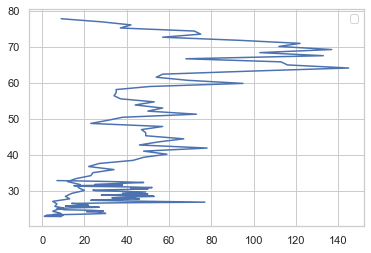

In [217]:
plt.plot(data[15:], forecast.trend)
plt.legend()
# py.iplot(fig) 

# fig = m.plot(forecast)
# a = add_changepoints_to_plot(fig.gca(), m, forecast)

In [218]:
cnfrm = forecast.loc[:,['ds','trend']]
cnfrm = cnfrm[cnfrm['trend']>0]
cnfrm=cnfrm.tail(15)
cnfrm.columns = ['Date','Confirm']
cnfrm.head()

,Date,Confirm
118,2020-06-16,30.463345
119,2020-06-17,30.639374
120,2020-06-18,30.815403
121,2020-06-19,30.991431
122,2020-06-20,31.167460


## Graphical Representation of Prediction

## Autoregressive integrated moving average(Arima)

### Making data ready for Arima

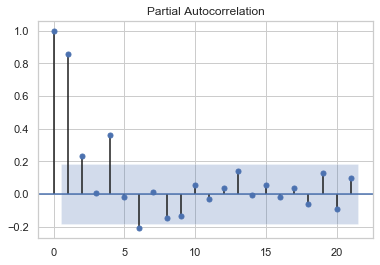

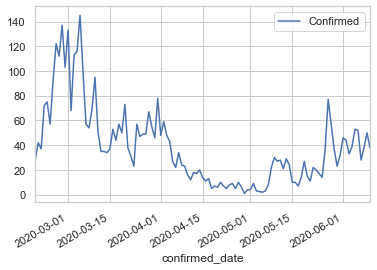

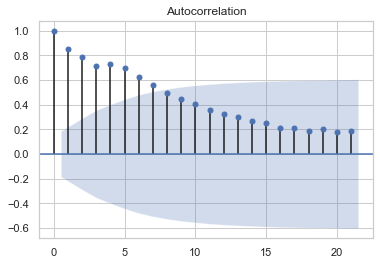

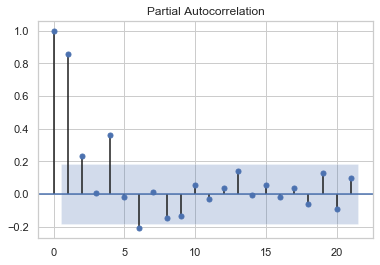

In [219]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
#시계열 자료 {  Yt } 의 상관 함수는 acf, pacf, iacf 가 있는데 이는 ARMA 모형 진단에 사용된다.
diff_1=train_data.diff(periods=1).iloc[1:] # diff() 차분함수 => 1차 차분함수
diff_1.plot()
plot_acf(diff_1)
plot_pacf(diff_1)

In [220]:
#!pip install --user pmdarima

In [221]:
# from pmdarima import auto_arima¶
# auto_arima(accumulated_count, seasonal=False)
# 한달간 일어난 전염병 시계열데이터로 계절성 요인은 False 로 지정한다.

# Auto_arima() 함수를 이용해서 p,d,q=() 알아낼수 있다.

# 위의 ACF, PCAF 를 참고해서 (1,2,1)로 대입했을때 가장 적은 AIC =215, BIC =217로 설명됨을 확인했다

In [ ]:
# !pip install pyramid-arima

In [ ]:
# from pmdarima import auto_arima
# auto_arima(accumulated_count, seasonal=False)